# Forecasting Happiness
By Leong Ko Rixie Tiffany, Kannan Shivani and Duan Yiting

- [Problem Formulation](#Problem-Formulation)
- [Data Preparation](#Data-Preparation)
- [Exploratory Analysis](#Exploratory-Analysis)
- [Clustering](#Clustering)
- [Regression](#Regression)
- [Forecasting](#Forecasting)
- [Conclusion](#Conclusion)

# Problem Formulation
[Back](#Forecasting-Happiness)

- Dataset: World Happiness Report 2018
- Problem: Based on the values of happiness & its supporting factors from 2005 to 2016, predict the happiness values in 2017
- Tools used: Clustering, regression & forecasting

# Data Preparation
[Back](#Forecasting-Happiness)

- [Import Libraries](#Import-Libraries)
- [Import Happiness Data](#Import-Happiness-Data)
- [Add Additional Columns](#Add-Additional-Columns)
- [Dealing with NULL Values](#Dealing-with-NULL-Values)
- [Renaming Columns](#Renaming-Columns)
- [Export to CSV](#Export-to-CSV)

## Import Libraries
[Back](#Data-Preparation)

### Essential Libraries

In [1]:
import numpy as np
import pandas as pd
import seaborn as sb
import matplotlib.pyplot as plt
sb.set()

### Plotly

In [2]:
import plotly.plotly as py
import plotly.graph_objs as go
import plotly.offline as py
import plotly.figure_factory as ff
from plotly import tools
py.init_notebook_mode(connected = False)

## Import Happiness Data
[Back](#Data-Preparation)

### Import Data
- Import Table2.1 from [World Happiness Report 2018](https://s3.amazonaws.com/happiness-report/2018/WHR2018Chapter2OnlineData.xls)

In [3]:
happiness_data = pd.read_excel("WHR2018Chapter2OnlineData.xls", sheet_name = 'Table2.1', header = 0)
happiness_data.head()

,country,year,Life Ladder,Log GDP per capita,Social support,Healthy life expectancy at birth,Freedom to make life choices,Generosity,Perceptions of corruption,Positive affect,Negative affect,Confidence in national government,Democratic Quality,Delivery Quality,Standard deviation of ladder by country-year,Standard deviation/Mean of ladder by country-year,GINI index (World Bank estimate),"GINI index (World Bank estimate), average 2000-15","gini of household income reported in Gallup, by wp5-year"
0,Afghanistan,2008,3.723590,7.168690,0.450662,49.209663,0.718114,0.181819,0.881686,0.517637,0.258195,0.612072,-1.929690,-1.655084,1.774662,0.476600,NaN,NaN,NaN
1,Afghanistan,2009,4.401778,7.333790,0.552308,49.624432,0.678896,0.203614,0.850035,0.583926,0.237092,0.611545,-2.044093,-1.635025,1.722688,0.391362,NaN,NaN,0.441906
2,Afghanistan,2010,4.758381,7.386629,0.539075,50.008961,0.600127,0.137630,0.706766,0.618265,0.275324,0.299357,-1.991810,-1.617176,1.878622,0.394803,NaN,NaN,0.327318
3,Afghanistan,2011,3.831719,7.415019,0.521104,50.367298,0.495901,0.175329,0.731109,0.611387,0.267175,0.307386,-1.919018,-1.616221,1.785360,0.465942,NaN,NaN,0.336764
4,Afghanistan,2012,3.782938,7.517126,0.520637,50.709263,0.530935,0.247159,0.775620,0.710385,0.267919,0.435440,-1.842996,-1.404078,1.798283,0.475367,NaN,NaN,0.344540


In [4]:
print("Data type: ", type(happiness_data))
print("Data dimensions: ", happiness_data.shape)

Data type:  <class 'pandas.core.frame.DataFrame'>
Data dimensions:  (1562, 19)


In [5]:
happiness_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1562 entries, 0 to 1561
Data columns (total 19 columns):
country                                                     1562 non-null object
year                                                        1562 non-null int64
Life Ladder                                                 1562 non-null float64
Log GDP per capita                                          1535 non-null float64
Social support                                              1549 non-null float64
Healthy life expectancy at birth                            1553 non-null float64
Freedom to make life choices                                1533 non-null float64
Generosity                                                  1482 non-null float64
Perceptions of corruption                                   1472 non-null float64
Positive affect                                             1544 non-null float64
Negative affect                                             1550 non-null fl

## Add Additional Columns
[Back](#Data-Preparation)

### Population & Log Population

#### Import Data
- Import population data from the [World Bank](https://data.worldbank.org/indicator/SP.POP.TOTL?view=chart)

In [6]:
pop_data = pd.read_csv("PopulationData.csv", header = 0)
pop_data.set_index("Country Name", inplace = True)
pop_data.head()

,Country Code,Indicator Name,Indicator Code,1960,1961,1962,1963,1964,1965,1966,...,2010,2011,2012,2013,2014,2015,2016,2017,2018,Unnamed: 63
Country Name,,,,,,,,,,,,,,,,,,,,,
Aruba,ABW,"Population, total",SP.POP.TOTL,54211.0,55438.0,56225.0,56695.0,57032.0,57360.0,57715.0,...,101669.0,102053.0,102577.0,103187.0,103795.0,104341.0,104822.0,105264.0,NaN,NaN
Afghanistan,AFG,"Population, total",SP.POP.TOTL,8996351.0,9166764.0,9345868.0,9533954.0,9731361.0,9938414.0,10152331.0,...,28803167.0,29708599.0,30696958.0,31731688.0,32758020.0,33736494.0,34656032.0,35530081.0,NaN,NaN
Angola,AGO,"Population, total",SP.POP.TOTL,5643182.0,5753024.0,5866061.0,5980417.0,6093321.0,6203299.0,6309770.0,...,23369131.0,24218565.0,25096150.0,25998340.0,26920466.0,27859305.0,28813463.0,29784193.0,NaN,NaN
Albania,ALB,"Population, total",SP.POP.TOTL,1608800.0,1659800.0,1711319.0,1762621.0,1814135.0,1864791.0,1914573.0,...,2913021.0,2905195.0,2900401.0,2895092.0,2889104.0,2880703.0,2876101.0,2873457.0,NaN,NaN
Andorra,AND,"Population, total",SP.POP.TOTL,13411.0,14375.0,15370.0,16412.0,17469.0,18549.0,19647.0,...,84449.0,83751.0,82431.0,80788.0,79223.0,78014.0,77281.0,76965.0,NaN,NaN


#### Dealing Missing Countries

In [7]:
# Countries in happiness_data, but not in pop_data
for i in happiness_data["country"].unique():
    if not (i in pop_data.index):
        print(i)

Congo (Brazzaville)
Congo (Kinshasa)
Egypt
Hong Kong S.A.R. of China
Iran
Ivory Coast
Kyrgyzstan
Laos
Macedonia
North Cyprus
Palestinian Territories
Russia
Slovakia
Somaliland region
South Korea
Swaziland
Syria
Taiwan Province of China
Venezuela
Yemen


In [8]:
# Rename country names to match the happiness_data
pop_data.rename(index = {
    "Congo, Dem. Rep.": "Congo (Kinshasa)",
    "Congo, Rep.": "Congo (Brazzaville)",
    "Egypt, Arab Rep.": "Egypt",
    "Hong Kong SAR, China": "Hong Kong S.A.R. of China",
    "Iran, Islamic Rep.": "Iran",
    "Cote d'Ivoire": "Ivory Coast",
    "Kyrgyz Republic": "Kyrgyzstan",
    "Lao PDR": "Laos",
    "Macedonia, FYR": "Macedonia",
    "West Bank and Gaza": "Palestinian Territories",
    "Russian Federation": "Russia",
    "Slovak Republic": "Slovakia",
    "Korea, Rep.": "South Korea",
    "Syrian Arab Republic": "Syria",
    "Venezuela, RB": "Venezuela",
    "Yemen, Rep.": "Yemen"
}, inplace = True)

In [9]:
# Fill in countries without values with values from Wikipedia
pop_data.loc["North Cyprus"] = 326000
pop_data.loc["Somaliland region"] = 3508180
pop_data.loc["Swaziland"] = 1093238
pop_data.loc["Taiwan Province of China"] = 23577271

#### Add to `happiness_data`

In [10]:
# Population
for i in range(len(happiness_data)):
    year = str(happiness_data.loc[i, "year"])
    country_name = happiness_data.loc[i, "country"]
    if (year in pop_data.columns and country_name in pop_data.index):
        happiness_data.loc[i, "Population"] = pop_data.loc[country_name, year]

# Log Population
happiness_data["Log Population"] = np.log(happiness_data["Population"])

### Region

#### Import Data
- Import SupportingFactors from [World Happiness Report 2018](https://s3.amazonaws.com/happiness-report/2018/WHR2018Chapter2OnlineData.xls)

In [11]:
happiness_region_data = pd.read_excel("WHR2018Chapter2OnlineData.xls", sheet_name = 'SupportingFactors', header = 0)
happiness_region_data = happiness_region_data[["country", "Region indicator"]]
happiness_region_data.head()

,country,Region indicator
0,Afghanistan,South Asia
1,Albania,Central and Eastern Europe
2,Algeria,Middle East and North Africa
3,Angola,Sub-Saharan Africa
4,Argentina,Latin America and Caribbean


#### Missing Countries

In [12]:
# Countries in happiness_data, but not in happiness_region_data
for i in happiness_data["country"].unique():
    if not (i in happiness_region_data["country"].unique()):
        print(i)

Comoros
Cuba
Djibouti
Guyana
Oman
Somaliland region
Suriname
Swaziland


In [13]:
# Assign regions to the missing countries
regions_to_add = [
    {
        "country": "Comoros",
        "Region indicator": "Sub-Saharan Africa"
    },
    {
        "country": "Cuba",
         "Region indicator": "Latin America and Caribbean"
    },
    {
        "country": "Djibouti",
        "Region indicator": "Sub-Saharan Africa"
    },
    {
        "country": "Guyana",
        "Region indicator": "Latin America and Caribbean"
    },
    {
        "country": "Oman",
        "Region indicator": "Middle East and North Africa"
    },
    {
        "country": "Somaliland region",
        "Region indicator": "Sub-Saharan Africa"
    },
    {
        "country": "Suriname",
        "Region indicator": "Latin America and Caribbean"
    },
    {
        "country": "Swaziland",
        "Region indicator": "Sub-Saharan Africa"
    }
]

for i in regions_to_add:
    happiness_region_data = happiness_region_data.append(i, ignore_index = True)

#### Add to `happiness_data`

In [14]:
happiness_data = pd.merge(happiness_data, happiness_region_data, on = "country", how = "left")
happiness_data["Region indicator"] = happiness_data["Region indicator"].astype("category")

In [15]:
# Reorder the columns to move Regions to the leftmost column
cols = happiness_data.columns.tolist()
happiness_data = happiness_data[cols[:2] + cols[-1:] + cols[2:-1]]

## Dealing with NULL Values
[Back](#Data-Preparation)

In [16]:
# Drop columns (e.g. derived data, mostly null data (> 25%), repeated columns)
happiness_data.drop(columns = ["Standard deviation of ladder by country-year", "Standard deviation/Mean of ladder by country-year", "Perceptions of corruption", "Confidence in national government", "GINI index (World Bank estimate)", "GINI index (World Bank estimate), average 2000-15"], inplace = True)

In [17]:
# If possible, fill the NULL values to the mean within countries
happiness_data[happiness_data.columns[4:]] = happiness_data.groupby("country")[happiness_data.columns[4:]].transform(lambda x: x.fillna(x.mean()))

In [18]:
# Otherwise, fill the remaining NULL values with the mean of the columns
happiness_data.fillna(happiness_data.mean(), inplace = True)

In [19]:
# Check if there's any NULL values left
happiness_data.isnull().values.any()

False

## Renaming Columns
[Back](#Data-Preparation)

In [20]:
# General: Title Case
happiness_data.columns = happiness_data.columns.str.title()

In [21]:
# Manually rename columns
happiness_data.rename(columns = {
    "country": "Country",
    "Life Ladder": "Happiness",
    "Log Gdp Per Capita": "Log GDP Per Capita",
    "Healthy Life Expectancy At Birth": "Healthy Life Expectancy",
    "Gini Of Household Income Reported In Gallup, By Wp5-Year": "Gini Index",
    "Region Indicator": "Region"
}, inplace = True)

## Export to CSV
[Back](#Data-Preparation)

In [22]:
# Export to CSV
happiness_data.to_csv("happiness_data.csv", index = False)

In [23]:
# Import from CSV
happiness_data = pd.read_csv("happiness_data.csv", header = 0)
happiness_data["Region"] = happiness_data["Region"].astype("category")

In [24]:
happiness_data.head()

,Country,Year,Region,Happiness,Log GDP Per Capita,Social Support,Healthy Life Expectancy,Freedom To Make Life Choices,Generosity,Positive Affect,Negative Affect,Democratic Quality,Delivery Quality,Gini Index,Population,Log Population
0,Afghanistan,2008,South Asia,3.723590,7.168690,0.450662,49.209663,0.718114,0.181819,0.517637,0.258195,-1.929690,-1.655084,0.385668,27294031.0,17.122179
1,Afghanistan,2009,South Asia,4.401778,7.333790,0.552308,49.624432,0.678896,0.203614,0.583926,0.237092,-2.044093,-1.635025,0.441906,28004331.0,17.147870
2,Afghanistan,2010,South Asia,4.758381,7.386629,0.539075,50.008961,0.600127,0.137630,0.618265,0.275324,-1.991810,-1.617176,0.327318,28803167.0,17.175996
3,Afghanistan,2011,South Asia,3.831719,7.415019,0.521104,50.367298,0.495901,0.175329,0.611387,0.267175,-1.919018,-1.616221,0.336764,29708599.0,17.206947
4,Afghanistan,2012,South Asia,3.782938,7.517126,0.520637,50.709263,0.530935,0.247159,0.710385,0.267919,-1.842996,-1.404078,0.344540,30696958.0,17.239674


# Exploratory Analysis
[Back](#Forecasting-Happiness)

- [Vital Statistics](#Vital-Statistics)
- [Description of Variables](#Description-of-Variables)
- [Numeric Data Analysis](#Numeric-Data-Analysis)
- [Categorical Data Analysis](#Categorical-Data-Analysis)
- [Sorted Happiness](#Sorted-Happiness)
- [Time-Series Analysis](#Time-Series-Analysis)

## Vital Statistics
[Back](#Exploratory-Analysis)

In [25]:
print("Data type: ", type(happiness_data))
print("Data dimensions: ", happiness_data.shape)

Data type:  <class 'pandas.core.frame.DataFrame'>
Data dimensions:  (1562, 16)


In [26]:
happiness_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1562 entries, 0 to 1561
Data columns (total 16 columns):
Country                         1562 non-null object
Year                            1562 non-null int64
Region                          1562 non-null category
Happiness                       1562 non-null float64
Log GDP Per Capita              1562 non-null float64
Social Support                  1562 non-null float64
Healthy Life Expectancy         1562 non-null float64
Freedom To Make Life Choices    1562 non-null float64
Generosity                      1562 non-null float64
Positive Affect                 1562 non-null float64
Negative Affect                 1562 non-null float64
Democratic Quality              1562 non-null float64
Delivery Quality                1562 non-null float64
Gini Index                      1562 non-null float64
Population                      1562 non-null float64
Log Population                  1562 non-null float64
dtypes: category(1), float64(13

## Description of Variables
[Back](#Exploratory-Analysis)
- **Country**: Country name
- **Year**: Year the data was obtained
- **Region**: Region the country belongs to
- **Happiness**: National average response to "Please imagine a ladder, with steps numbered from 0 at the bottom to 10 at the top. The top of the ladder represents the best possible life for you and the bottom of the ladder represents the worst possible life for you. On which step of the ladder would you say you personally feel you stand at this time?”
- **Log GDP Per Capita**: Natural logarithm of GDP per Capita
- **Social Support**: National average of response to “If you were in trouble, do you have relatives or friends you can count on to help you whenever you need them, or not?”
- **Healthy Life Expectancy**: Estimated expected years of life in good health for people in the country
- **Freedom To Make Life Choices**: National average response to “Are you satisfied or dissatisfied with your freedom to choose what you do with your life?”
- **Generosity**: Residual of regressing national average of response to “Have you donated money to a charity in the past month?” on GDP per capita
- **Positive Affect**: National average of 3 positive affect measures: “Did you experience the following feelings during A LOT OF THE DAY yesterday? How about Happiness?”, “Did you smile or laugh a lot yesterday?” and “Did you experience the following feelings during A LOT OF THE DAY yesterday? How about Enjoyment?”
- **Negative Affect**: National average of 3 negative affect measures: “Did you experience the following feelings during A LOT OF THE DAY yesterday? How about Worry?”, “Did you experience the following feelings during A LOT OF THE DAY yesterday? How about Sadness?” and “Did you experience the following feelings during A LOT OF THE DAY yesterday? How about Anger?”
- **Democratic Quality**: Average of Worldwide Governance Indicators: Voice and Accountability and Political Stability
- **Delivery Quality**: Average of Worldwide Governance Indicators: Absence of Violence, Government Effectiveness, Regulatory Quality, Rule of Law and Control of Corruption
- **Gini Index**: Measure how far a country's income distribution deviates from a totally equal distribution (0: Perfect equality, 1: Perfect inequality)
- **Population**: Population of the country
- **Log Population**: Natural logarithm of population

## Numeric Data Analysis
[Back](#Exploratory-Analysis)

### Select Numeric Data
- Excluding population as we use Log Population to normalise the population

In [27]:
numeric_data = happiness_data.select_dtypes(include = "float64").drop(columns = ["Population"])

### Uni-Variate Analysis

#### Statistical Summary
*Range 0 to 10*
- Happiness

*Range: 0 to 1*
- Social Support
- Freedom To Make Life Choices
- Positive Affect
- Negative Affect
- Gini Index

In [28]:
numeric_data.describe()

,Happiness,Log GDP Per Capita,Social Support,Healthy Life Expectancy,Freedom To Make Life Choices,Generosity,Positive Affect,Negative Affect,Democratic Quality,Delivery Quality,Gini Index,Log Population
count,1562.000000,1562.000000,1562.000000,1562.000000,1562.000000,1562.000000,1562.000000,1562.000000,1562.000000,1562.000000,1562.000000,1562.000000
mean,5.433676,9.221851,0.810811,62.249887,0.729813,-0.000394,0.708573,0.263306,-0.125359,0.004450,0.447347,16.440607
std,1.121017,1.179980,0.119104,7.937689,0.145343,0.162186,0.107404,0.083841,0.864942,0.971548,0.103449,1.491268
min,2.661718,6.377396,0.290184,37.766476,0.257534,-0.322952,0.362498,0.083426,-2.448228,-2.144974,0.223470,12.606214
25%,4.606351,8.320263,0.748375,57.344959,0.633908,-0.113578,0.621528,0.204411,-0.766652,-0.710473,0.372516,15.463643
50%,5.332600,9.382836,0.833072,63.763542,0.748506,-0.021522,0.716673,0.251966,-0.197186,-0.193147,0.427400,16.276568
75%,6.271025,10.191471,0.904170,68.064693,0.845789,0.091421,0.799524,0.311515,0.647371,0.700297,0.511649,17.402278
max,8.018934,11.770276,0.987343,76.536362,0.985178,0.677773,0.943621,0.704590,1.540097,2.184725,0.961435,21.049973


#### Visualisation
*Most Like Normal Distribution*
- Generosity
- Negative Affect
- Gini Index
- Log Population

*Uneven Distribution*
- Log GDP Per Capita
- Life Expectancy (2 peaks)
- Positive Affect
- Democratic Quality
- Delivery Quality

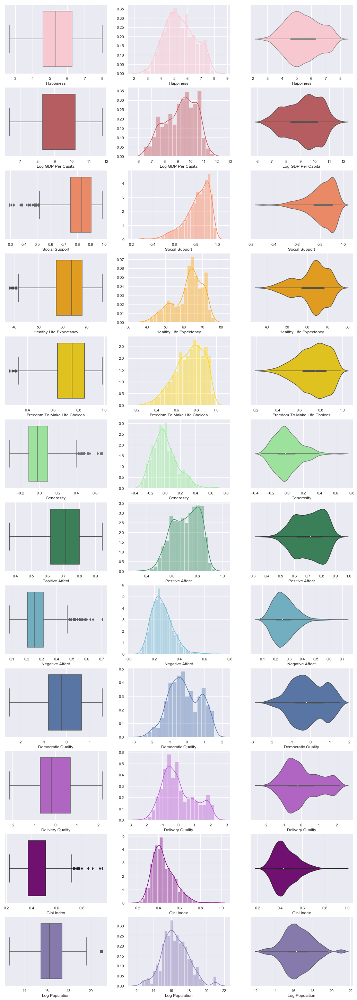

In [29]:
f, axes = plt.subplots(12, 3, figsize = (18, 52))
colors = ["pink", "r", "coral", "orange", "gold", "lightgreen", "seagreen", "c", "b", "mediumorchid", "purple", "m"]

count = 0

for var in numeric_data.columns:
    sb.boxplot(numeric_data[var], ax = axes[count,0], color = colors[count])
    sb.distplot(numeric_data[var], ax = axes[count,1], color = colors[count])
    sb.violinplot(numeric_data[var], ax = axes[count,2], color = colors[count])
    count += 1

### Multi-Variate Analysis

#### Pairplot

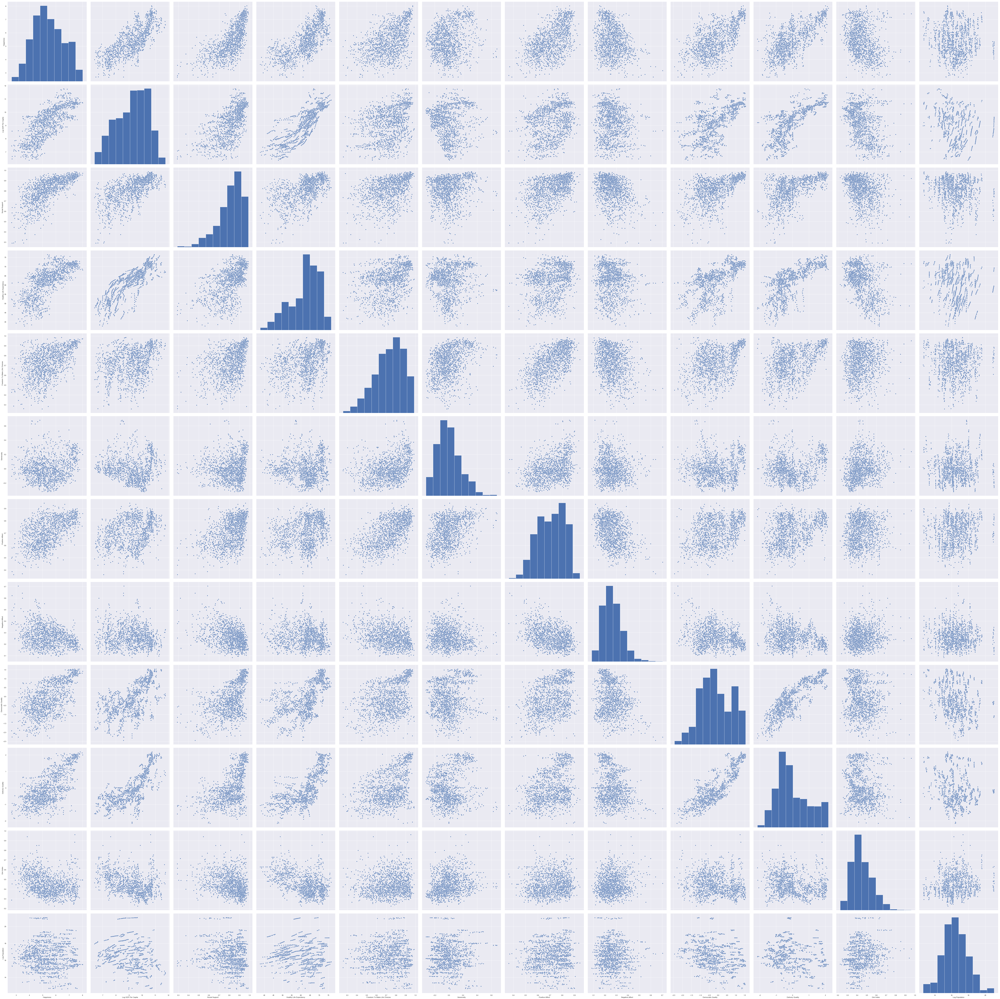

In [30]:
sb.pairplot(numeric_data, height = 8)

#### Correlation

,Happiness,Log GDP Per Capita,Social Support,Healthy Life Expectancy,Freedom To Make Life Choices,Generosity,Positive Affect,Negative Affect,Democratic Quality,Delivery Quality,Gini Index,Log Population
Happiness,1.000000,0.779426,0.700664,0.729544,0.519393,0.200041,0.553049,-0.266062,0.610389,0.707507,-0.299697,-0.048889
Log GDP Per Capita,0.779426,1.000000,0.655974,0.839996,0.359105,0.000660,0.315742,-0.131888,0.627735,0.767164,-0.389856,-0.118462
Social Support,0.700664,0.655974,1.000000,0.586629,0.416922,0.075447,0.459764,-0.350740,0.539896,0.551502,-0.308885,-0.112899
Healthy Life Expectancy,0.729544,0.839996,0.586629,1.000000,0.339263,0.045255,0.296600,-0.102992,0.600887,0.723744,-0.452790,-0.084049
Freedom To Make Life Choices,0.519393,0.359105,0.416922,0.339263,1.000000,0.346998,0.614260,-0.284348,0.421056,0.464584,0.084268,0.003426
Generosity,0.200041,0.000660,0.075447,0.045255,0.346998,1.000000,0.371681,-0.103686,0.110254,0.197604,0.216261,0.014149
Positive Affect,0.553049,0.315742,0.459764,0.296600,0.614260,0.371681,1.000000,-0.383623,0.371382,0.366937,0.093612,0.122495
Negative Affect,-0.266062,-0.131888,-0.350740,-0.102992,-0.284348,-0.103686,-0.383623,1.000000,-0.226349,-0.240768,0.125087,-0.050862
Democratic Quality,0.610389,0.627735,0.539896,0.600887,0.421056,0.110254,0.371382,-0.226349,1.000000,0.864501,-0.158059,-0.291556
Delivery Quality,0.707507,0.767164,0.551502,0.723744,0.464584,0.197604,0.366937,-0.240768,0.864501,1.000000,-0.183701,-0.158103


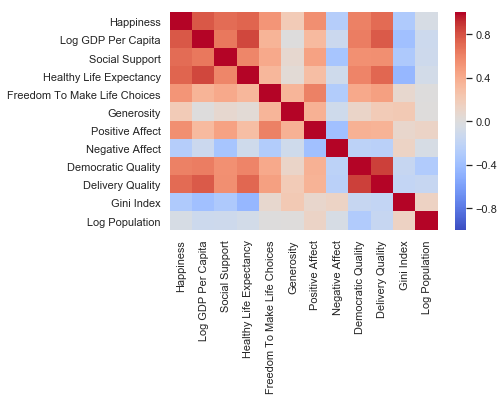

In [31]:
sb.heatmap(numeric_data.corr(), vmin = -1, vmax = 1, cmap = "coolwarm")
numeric_data.corr()

#### Analysis
- The best predictors for happiness appear to be Log GDP per Capita (0.78), Healthy Life Expectancy (0.73), Delivery Quality (0.71) and Social Support (0.70)
- Log GDP Per Capita has a high positive correlation with Healthy Life Expectancy (0.84)
- Democratic Quality has a high positive correlation with Delivery Quality (0.86)

## Categorical Data Analysis
[Back](#Exploratory-Analysis)

### Year

In [32]:
print("Number of Years:\t", len(happiness_data["Year"].unique()))
print(happiness_data["Year"].value_counts().sort_index())
pd.DataFrame(happiness_data["Year"]).describe()

Number of Years:	 13
2005     27
2006     89
2007    102
2008    110
2009    114
2010    124
2011    146
2012    142
2013    137
2014    145
2015    143
2016    142
2017    141
Name: Year, dtype: int64


,Year
count,1562.000000
mean,2011.820743
std,3.419787
min,2005.000000
25%,2009.000000
50%,2012.000000
75%,2015.000000
max,2017.000000


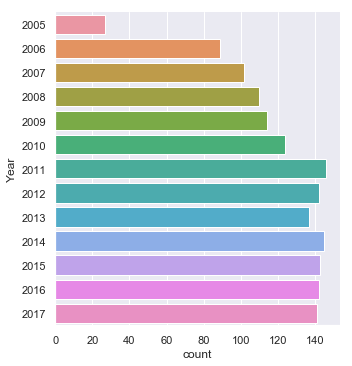

In [33]:
sb.catplot(y = "Year", data = happiness_data, kind = "count")

#### Mean Values by Year
- 2005 seems to have abnormally higher Happiness, Log GDP Per Capita, Social Support, Democratic Quality & Delivery Quality (this is possibly because of the small sample size)

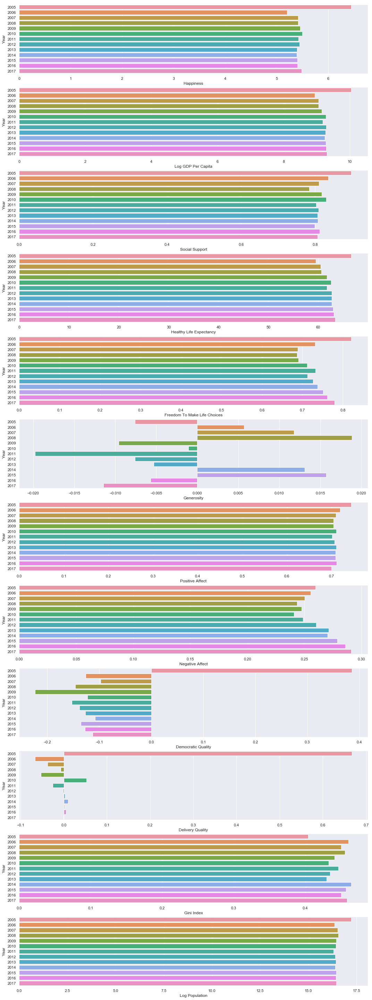

In [34]:
f, axes = plt.subplots(12, 1, figsize = (18, 52))
mean_data = happiness_data.groupby("Year").mean().reset_index()

count = 0
for i in numeric_data.columns:
    sb.barplot(x = i, y = "Year", data = mean_data, orient = "h", ax = axes[count])
    count += 1

### Region

In [35]:
print("Number of Regions:\t", len(happiness_data["Region"].unique()))
print(happiness_data["Region"].value_counts().sort_index())
pd.DataFrame(happiness_data["Region"]).describe()

Number of Regions:	 10
Central and Eastern Europe            176
Commonwealth of Independent States    139
East Asia                              65
Latin America and Caribbean           239
Middle East and North Africa          182
North America and ANZ                  45
South Asia                             72
Southeast Asia                         93
Sub-Saharan Africa                    340
Western Europe                        211
Name: Region, dtype: int64


,Region
count,1562
unique,10
top,Sub-Saharan Africa
freq,340


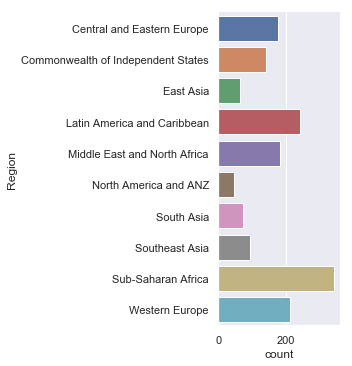

In [36]:
sb.catplot(y = "Region", data = happiness_data, kind = "count")

#### Mean Value by Region

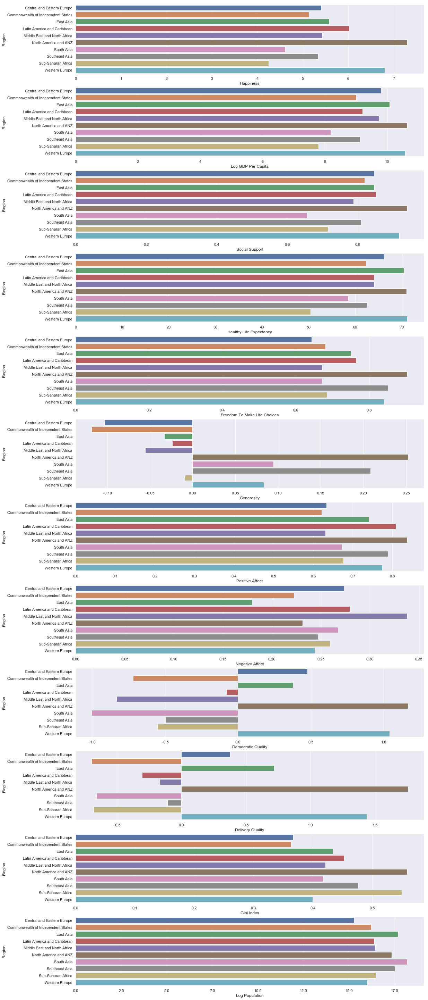

In [37]:
f, axes = plt.subplots(12, 1, figsize = (18, 52))
mean_data = happiness_data.groupby("Region").mean().reset_index()

count = 0
for i in numeric_data.columns:
    sb.barplot(x = i, y = "Region", data = mean_data, orient = "h", ax = axes[count])
    count += 1

## Sorted Happiness
[Back](#Exploratory-Analysis)
- The interquartile range appears to get larger towards the bottom, with a few exceptions such as Venezuela

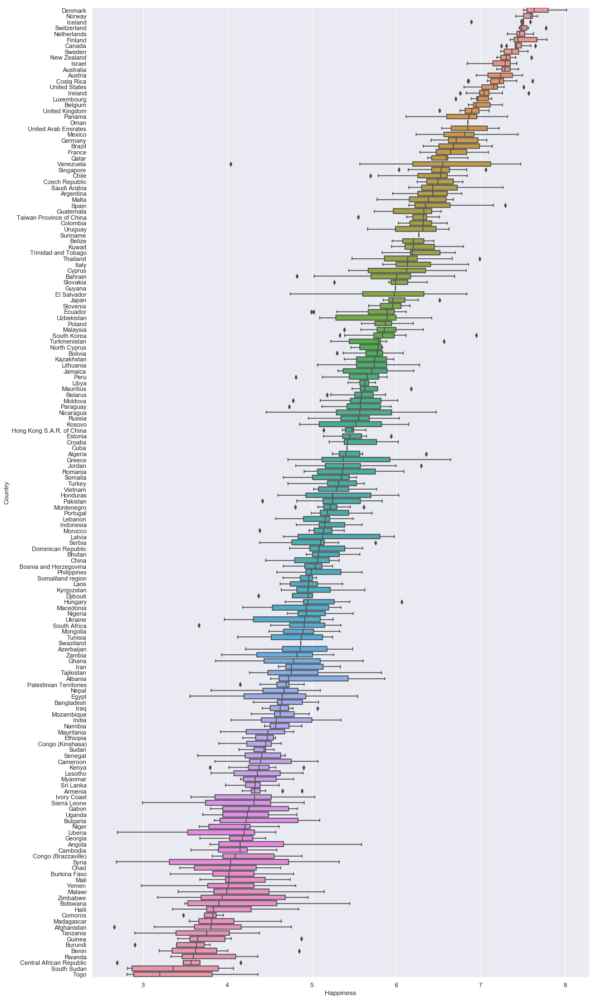

In [38]:
# Boxplots sorted by median
sorted_data = pd.DataFrame({col:vals["Happiness"] for col,vals in happiness_data.groupby(["Country"])})
meds = sorted_data.median().sort_values(ascending = False)

f, axes = plt.subplots(1, 1, figsize = (16, 32))
sb.boxplot(x = "Happiness", y = "Country", orient = 'h', data = happiness_data, order = meds.index)

## Time-Series Analysis
[Back](#Exploratory-Analysis)

### Time-Series of Mean Values by Region
- For all variables except negative affect and Log Population, North America and ANZ generally has higher values on average compared to other regions
- For all variable except Positive Affect, Negative Affect, Democratic Quality, Gini Index and Log Population, South Asia and Sub-Saharan Africa generally has lower values on average compared to other regions
- Besides from 2005 to 2006, which is likely due to small sample size, the global trend for most variables remains unchanged

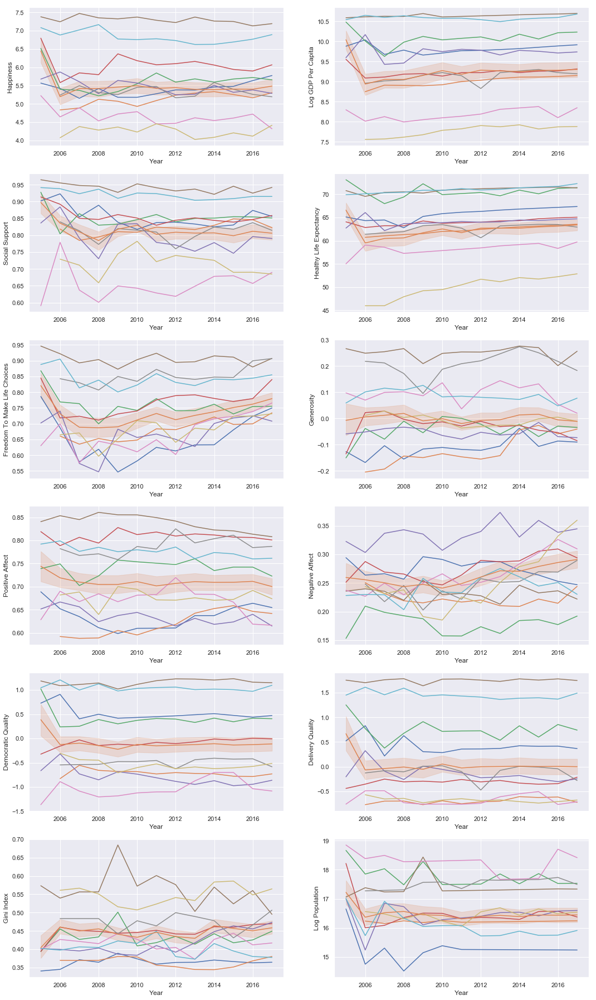

In [39]:
f, axes = plt.subplots(6, 2, figsize = (18, 32))

count = 0
year_data = happiness_data.groupby(["Region", "Year"]).mean().sort_values(by = ["Region", "Year"]).reset_index()

for i in numeric_data.columns:
    sb.lineplot(x = "Year", y = i, hue = "Region", data = year_data, ax = axes[count // 2, count % 2], legend = None)
    sb.lineplot(x = "Year", y = i, data = happiness_data, ax = axes[count // 2, count % 2], palette = "pastel")
    count += 1

### Animated Time-Series
- Start from 2006 as very few countries contain data for 2005

#### Fill in Empty Years with Mean Data
- The animated time-series require full data for all years

In [40]:
countries = happiness_data["Country"].unique()
bubble_data = happiness_data.copy()

for country in countries:
    country_data = bubble_data[bubble_data["Country"] == country]
    for year in range(2006, 2018):
        if (len(country_data[country_data["Year"] == year]) == 0):
            bubble_data.loc[len(bubble_data), "Country"] = country
            bubble_data.loc[len(bubble_data) - 1, "Region"] = country_data.iloc[0].Region
            bubble_data.loc[len(bubble_data) - 1, "Year"] = year

bubble_data[bubble_data.columns[3:]] = bubble_data.groupby("Country")[bubble_data.columns[3:]].transform(lambda x: x.fillna(x.mean()))
bubble_data.sort_values(by="Country", inplace = True)

#### Time-Series of Happiness vs Log GDP Per Capita
- We use Log GDP Per Capita because it has the highest correlation with Happiness
- There's a consistent linear relationship
- Log GDP Per Capita appears to remain somewhat the same
- Happiness tends to go up and down, with no particular trend

In [41]:
years = range(2006, 2018)
regions = bubble_data["Region"].unique()

figure = {
    'data': [],
    'layout': {},
    'frames': []
}

# Data
year = 2006
for region in regions:
    year_data = bubble_data[bubble_data['Year'] == year]
    year_region_data = year_data[year_data['Region'] == region]

    data_dict = {
        'x': list(year_region_data['Log GDP Per Capita']),
        'y': list(year_region_data['Happiness']),
        'mode': 'markers',
        'text': list(year_region_data['Country']),
        'marker': {
            'sizemode': 'area',
            'sizeref': 200000,
            'size': list(year_region_data["Population"])
        },
        'name': region
    }
    
    figure['data'].append(data_dict)

# Layout
figure['layout']['xaxis'] = {'range': [5, 14], 'title': 'Log GDP per Capita'}
figure['layout']['yaxis'] = {'range': [2, 9], 'title': 'Happiness'}
figure['layout']['hovermode'] = 'closest'
figure['layout']['sliders'] = {
    'args': [
        'transition', {
            'duration': 500,
            'easing': 'cubic-in-out'
        }
    ],
    'initialValue': 2006,
    'plotlycommand': 'animate',
    'values': years,
    'visible': True
}

# Buttons
figure['layout']['updatemenus'] = [
    {
        'buttons': [
            {
                'args': [None, {'frame': {'duration': 500, 'redraw': False},
                         'fromcurrent': True, 'transition': {'duration': 300, 'easing': 'quadratic-in-out'}}],
                'label': 'Play',
                'method': 'animate'
            },
            {
                'args': [[None], {'frame': {'duration': 0, 'redraw': False}, 'mode': 'immediate',
                'transition': {'duration': 0}}],
                'label': 'Pause',
                'method': 'animate'
            }
        ],
        'direction': 'left',
        'pad': {'r': 10, 't': 87},
        'showactive': False,
        'type': 'buttons',
        'x': 0.1,
        'xanchor': 'right',
        'y': 0,
        'yanchor': 'top'
    }
]   

sliders_dict = {
    'active': 0,
    'yanchor': 'top',
    'xanchor': 'left',
    'currentvalue': {
        'font': {'size': 20},
        'prefix': "Year: ",
        'visible': True,
        'xanchor': 'right'
    },
    'transition': {'duration': 300, 'easing': 'cubic-in-out'},
    'pad': {'b': 10, 't': 50},
    'len': 0.9,
    'x': 0.1,
    'y': 0,
    'steps': []
}

# make frames
for year in years:
    frame = {'data': [], 'name': str(year)}

    for region in regions:
        year_data = bubble_data[bubble_data['Year'] == year]
        year_region_data = year_data[year_data['Region'] == region]

        data_dict = {
            'x': list(year_region_data['Log GDP Per Capita']),
            'y': list(year_region_data["Happiness"]),
            'mode': 'markers',
            'text': list(year_region_data['Country']),
            'marker': {
                'sizemode': 'area',
                'sizeref': 200000,
                'size': list(year_region_data["Population"])
            },
            'name': region
        }
        frame['data'].append(data_dict)

    figure['frames'].append(frame)

    slider_step = {'args': [
        [year],
        {
            'frame': {'duration': 300, 'redraw': False},
            'mode': 'immediate',
            'transition': {'duration': 300}
        }
     ],
     'label': year,
     'method': 'animate'}
    sliders_dict['steps'].append(slider_step)

    
figure['layout']['sliders'] = [sliders_dict]

py.iplot(figure)

#### Time-Series of Log GDP Per Capita vs Healthy Life Expectancy
- We use Log GDP Per Capita and Healthy Life Expectancy because they have the highest mutual correlation
- There's a consistent linear relationship
- Log GDP Per Capita appears to remain somewhat the same
- Healthy Life Expectancy appears to be increasing

In [42]:
years = range(2006, 2018)
regions = bubble_data["Region"].unique()

figure = {
    'data': [],
    'layout': {},
    'frames': []
}

# Data
year = 2006
for region in regions:
    year_data = bubble_data[bubble_data['Year'] == year]
    year_region_data = year_data[year_data['Region'] == region]

    data_dict = {
        'x': list(year_region_data['Log GDP Per Capita']),
        'y': list(year_region_data['Healthy Life Expectancy']),
        'mode': 'markers',
        'text': list(year_region_data['Country']),
        'marker': {
            'sizemode': 'area',
            'sizeref': 200000,
            'size': list(year_region_data["Population"])
        },
        'name': region
    }
    
    figure['data'].append(data_dict)

# Layout
figure['layout']['xaxis'] = {'range': [5, 14], 'title': 'Log GDP per Capita'}
figure['layout']['yaxis'] = {'range': [30, 90], 'title': 'Healthy Life Expectancy'}
figure['layout']['hovermode'] = 'closest'
figure['layout']['sliders'] = {
    'args': [
        'transition', {
            'duration': 500,
            'easing': 'cubic-in-out'
        }
    ],
    'initialValue': 2006,
    'plotlycommand': 'animate',
    'values': years,
    'visible': True
}

# Buttons
figure['layout']['updatemenus'] = [
    {
        'buttons': [
            {
                'args': [None, {'frame': {'duration': 500, 'redraw': False},
                         'fromcurrent': True, 'transition': {'duration': 300, 'easing': 'quadratic-in-out'}}],
                'label': 'Play',
                'method': 'animate'
            },
            {
                'args': [[None], {'frame': {'duration': 0, 'redraw': False}, 'mode': 'immediate',
                'transition': {'duration': 0}}],
                'label': 'Pause',
                'method': 'animate'
            }
        ],
        'direction': 'left',
        'pad': {'r': 10, 't': 87},
        'showactive': False,
        'type': 'buttons',
        'x': 0.1,
        'xanchor': 'right',
        'y': 0,
        'yanchor': 'top'
    }
]   

sliders_dict = {
    'active': 0,
    'yanchor': 'top',
    'xanchor': 'left',
    'currentvalue': {
        'font': {'size': 20},
        'prefix': "Year: ",
        'visible': True,
        'xanchor': 'right'
    },
    'transition': {'duration': 300, 'easing': 'cubic-in-out'},
    'pad': {'b': 10, 't': 50},
    'len': 0.9,
    'x': 0.1,
    'y': 0,
    'steps': []
}

# make frames
for year in years:
    frame = {'data': [], 'name': str(year)}

    for region in regions:
        year_data = bubble_data[bubble_data['Year'] == year]
        year_region_data = year_data[year_data['Region'] == region]

        data_dict = {
            'x': list(year_region_data['Log GDP Per Capita']),
            'y': list(year_region_data["Healthy Life Expectancy"]),
            'mode': 'markers',
            'text': list(year_region_data['Country']),
            'marker': {
                'sizemode': 'area',
                'sizeref': 200000,
                'size': list(year_region_data["Population"])
            },
            'name': region
        }
        frame['data'].append(data_dict)

    figure['frames'].append(frame)

    slider_step = {'args': [
        [year],
        {
            'frame': {'duration': 300, 'redraw': False},
            'mode': 'immediate',
            'transition': {'duration': 300}
        }
     ],
     'label': year,
     'method': 'animate'}
    sliders_dict['steps'].append(slider_step)

    
figure['layout']['sliders'] = [sliders_dict]

py.iplot(figure)

#### Time-Series of Happiness on the Map
- Appears to have 3 distinct clusters (very happy in America and Australia, neutral in Asia, very unhappy in Africa)

In [43]:
years = range(2006, 2018)

regions = bubble_data["Region"].unique()

# Initialise Figure
figure = {
    'data': [],
    'layout': {},
    'frames': []
}

# Data
year = 2006
for region in regions:
    year_data = bubble_data[bubble_data['Year'] == year]
    year_region_data = year_data[year_data['Region'] == region]

    data_dict = go.Choropleth(
        locationmode = 'country names',
            locations = list(year_region_data['Country']),
            z = list(year_region_data['Happiness']),
            text = list(year_region_data['Country']),
            zmin = 2,
            zmax = 9,
            colorscale = "RdBu",
            autocolorscale = False,
            reversescale = True,
            marker = go.choropleth.Marker(
                line = go.choropleth.marker.Line(
                    color = 'rgb(180,180,180)',
                    width = 0.5
                )),
            name = region
    )
    
    figure['data'].append(data_dict)

# Layout
figure['layout']['title'] = 'Happiness'
figure['layout']['geo'] = go.layout.Geo(
    showframe = False,
    showcoastlines = False,
    projection = go.layout.geo.Projection(
        type = 'equirectangular'
    )
)
figure['layout']['hovermode'] = 'closest'
figure['layout']['sliders'] = {
    'args': [
        'transition', {
            'duration': 500,
            'easing': 'cubic-in-out'
        }
    ],
    'initialValue': 2006,
    'plotlycommand': 'animate',
    'values': years,
    'visible': True
}

figure['layout']['updatemenus'] = [
    {
        'buttons': [
            {
                'args': [None, {'frame': {'duration': 500, 'redraw': False},
                         'fromcurrent': True, 'transition': {'duration': 300, 'easing': 'quadratic-in-out'}}],
                'label': 'Play',
                'method': 'animate'
            },
            {
                'args': [[None], {'frame': {'duration': 0, 'redraw': False}, 'mode': 'immediate',
                'transition': {'duration': 0}}],
                'label': 'Pause',
                'method': 'animate'
            }
        ],
        'direction': 'left',
        'pad': {'r': 10, 't': 87},
        'showactive': False,
        'type': 'buttons',
        'x': 0.1,
        'xanchor': 'right',
        'y': 0,
        'yanchor': 'top'
    }
]

sliders_dict = {
    'active': 0,
    'yanchor': 'top',
    'xanchor': 'left',
    'currentvalue': {
        'font': {'size': 20},
        'prefix': "Year: ",
        'visible': True,
        'xanchor': 'right'
    },
    'transition': {'duration': 300, 'easing': 'cubic-in-out'},
    'pad': {'b': 10, 't': 50},
    'len': 0.9,
    'x': 0.1,
    'y': 0,
    'steps': []
}

# make frames
for year in years:
    frame = {'data': [], 'name': str(year)}
    
    for region in regions:
        year_data = bubble_data[bubble_data['Year'] == year]
        year_region_data = year_data[year_data['Region'] == region]

        data_dict = go.Choropleth(
            locationmode = 'country names',
            locations = list(year_region_data['Country']),
            z = list(year_region_data['Happiness']),
            text = list(year_region_data['Country']),
            zmin = 2,
            zmax = 9,
            colorscale = "RdBu",
            autocolorscale = False,
            reversescale = True,
            marker = go.choropleth.Marker(
                line = go.choropleth.marker.Line(
                    color = 'rgb(180,180,180)',
                    width = 0.5
                )),
            name = region
        )
        frame['data'].append(data_dict)

    figure['frames'].append(frame)
    
    slider_step = {'args': [
        [year],
        {
            'frame': {'duration': 300, 'redraw': False},
            'mode': 'immediate',
            'transition': {'duration': 300}
        }
     ],
     'label': year,
     'method': 'animate'}
    sliders_dict['steps'].append(slider_step)

figure['layout']['sliders'] = [sliders_dict]

py.iplot(figure)

# Clustering
[Back](#Forecasting-Happiness)

- [Generate Clusters](#Generate-Clusters)
- [Chloropleth Map](#Chloropleth-Map)
- [Pairplot of Clusters](#Pairplot-of-Clusters)
- [Silhouette Plot](#Silhouette-Plot)

In [44]:
# Extract mean variables for clustering
X = happiness_data.groupby("Country").mean()
X = X.select_dtypes(include = "float64").drop(columns = ["Year", "Population"])
X.head()

,Happiness,Log GDP Per Capita,Social Support,Healthy Life Expectancy,Freedom To Make Life Choices,Generosity,Positive Affect,Negative Affect,Democratic Quality,Delivery Quality,Gini Index,Log Population
Country,,,,,,,,,,,,
Afghanistan,3.806614,7.419697,0.517146,50.838271,0.544895,0.118428,0.580873,0.301283,-1.904737,-1.485251,0.385668,17.255111
Albania,4.988791,9.247059,0.723204,68.027213,0.626155,-0.105019,0.642628,0.303256,0.071527,-0.260937,0.492998,14.881232
Algeria,5.555004,9.501728,0.804633,64.984461,0.536398,-0.208236,0.616524,0.265460,-1.089971,-0.777121,0.491331,17.467275
Angola,4.420299,8.713935,0.737973,51.729801,0.455957,-0.077940,0.613339,0.351173,-0.743011,-1.180481,0.514382,17.055699
Argentina,6.406131,9.826051,0.906080,66.764205,0.753122,-0.154544,0.840998,0.273187,0.196643,-0.493677,0.349463,17.550058


## Generate Clusters
[Back](#Clustering)

### Define Cluster Methods
- **KMeans Clustering**
- Mean Shift Clustering
- Mini Batch KMeans Clustering
- **DBScan Clustering**
- Spectral Clustering
- Affinity Propagation Clustering
- Birch Clustering
- **Gaussian Mixture Clustering**

In [45]:
from sklearn import cluster, mixture

class ClusterMethodList(object) :
    def get_cluster_instance(self, argument,input_data,X):
        method_name = str(argument).lower()+ '_cluster'
        method = getattr(self,method_name, lambda : "Invalid Clustering method")
        return method(input_data, X)
    
    def kmeans_cluster(self,input_data,X):
        km = cluster.KMeans(n_clusters = input_data['n_clusters'] )
        return km.fit_predict(X)
   
    def meanshift_cluster(self,input_data,X):
        ms = cluster.MeanShift(bandwidth = input_data['bandwidth'])
        return  ms.fit_predict(X)
    
    def minibatchkmeans_cluster(self,input_data,X):
        two_means = cluster.MiniBatchKMeans(n_clusters = input_data['n_clusters'])
        return two_means.fit_predict(X)
   
    def dbscan_cluster(self,input_data,X):
        db = cluster.DBSCAN(eps = input_data['eps'])
        return db.fit_predict(X)
    
    def spectral_cluster(self,input_data,X):
        sp = cluster.SpectralClustering(n_clusters = input_data['n_clusters'])
        return sp.fit_predict(X)
   
    def affinitypropagation_cluster(self,input_data,X):
        affinity_propagation =  cluster.AffinityPropagation(damping = input_data['damping'], preference = input_data['preference'])
        affinity_propagation.fit(X)
        return affinity_propagation.predict(X)
       
    def birch_cluster(self,input_data,X):
        birch = cluster.Birch(n_clusters = input_data['n_clusters'])
        return birch.fit_predict(X)
   
    def gaussian_mixture_cluster(self,input_data,X):
        gmm = mixture.GaussianMixture(n_components = input_data['n_clusters'], covariance_type = 'full')
        gmm.fit(X)
        return gmm.predict(X)

### Start Clustering Process
- Creates a new column of cluster labels for each clustering method
- Plots a scatter plot of Happiness against Log GDP Per Capita, coloured based on the different clustering methods

In [46]:
import math

def startClusteringProcess(list_cluster_method, input_data, cols, data):
    rows = math.ceil(len(list_cluster_method) / cols)
    fig, ax = plt.subplots(rows, cols, figsize = (6 * cols, 4 * rows)) 
    
    cluster_list = ClusterMethodList()
    count = 0
    
    data_labelled = data.copy()
    
    for cl in list_cluster_method :
        cluster_labels = cluster_list.get_cluster_instance(cl, input_data, data)
        data_labelled[cl] = cluster_labels
        
        ax[count % rows, count // rows].scatter(data["Happiness"], data["Log GDP Per Capita"],  c = cluster_labels, s = 10, cmap = "viridis")
        ax[count % rows, count // rows].set_title(cl)
        count += 1
        
    return data_labelled

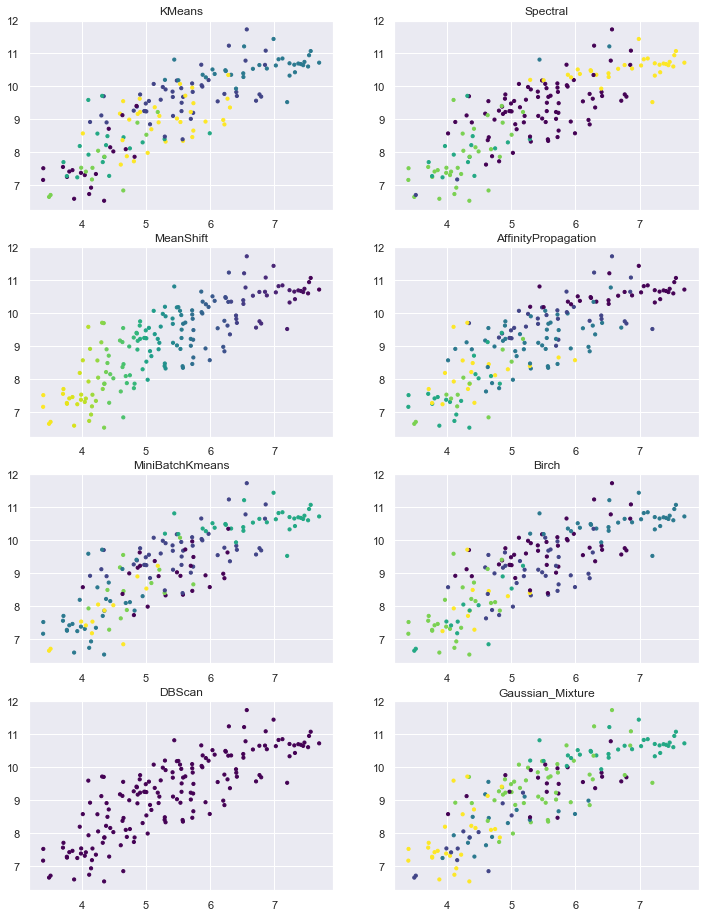

In [47]:
list_cluster_method = ['KMeans', "MeanShift", "MiniBatchKmeans", "DBScan", "Spectral", "AffinityPropagation", "Birch", "Gaussian_Mixture"]
input_data = {
    'n_clusters': 6,
    'eps': 0.3,
    'bandwidth': 0.2,
    'damping': 0.9,
    'preference': -200
}
cols = 2

X_labelled = startClusteringProcess(list_cluster_method, input_data, cols, X)

In [48]:
X_labelled.head()

,Happiness,Log GDP Per Capita,Social Support,Healthy Life Expectancy,Freedom To Make Life Choices,Generosity,Positive Affect,Negative Affect,Democratic Quality,Delivery Quality,Gini Index,Log Population,KMeans,MeanShift,MiniBatchKmeans,DBScan,Spectral,AffinityPropagation,Birch,Gaussian_Mixture
Country,,,,,,,,,,,,,,,,,,,,
Afghanistan,3.806614,7.419697,0.517146,50.838271,0.544895,0.118428,0.580873,0.301283,-1.904737,-1.485251,0.385668,17.255111,0,155,2,-1,4,3,4,5
Albania,4.988791,9.247059,0.723204,68.027213,0.626155,-0.105019,0.642628,0.303256,0.071527,-0.260937,0.492998,14.881232,1,98,1,-1,0,1,0,4
Algeria,5.555004,9.501728,0.804633,64.984461,0.536398,-0.208236,0.616524,0.265460,-1.089971,-0.777121,0.491331,17.467275,1,67,1,-1,0,2,0,0
Angola,4.420299,8.713935,0.737973,51.729801,0.455957,-0.077940,0.613339,0.351173,-0.743011,-1.180481,0.514382,17.055699,0,125,2,-1,4,3,4,5
Argentina,6.406131,9.826051,0.906080,66.764205,0.753122,-0.154544,0.840998,0.273187,0.196643,-0.493677,0.349463,17.550058,1,31,1,-1,0,1,0,0


## Chloropleth Map
[Back](#Clustering)

In [49]:
def plot_clusters(data, algorithm):
    labels = data[algorithm]
    
    data = dict(
        type = 'choropleth',
        locations = data.index,
        locationmode = 'country names',
        z = labels,
        colorscale = 'Viridis',
        colorbar = {'title': 'Cluster'}
    )
          
    layout = dict(
        title = format(str(algorithm)), 
        geo = dict(
            showframe = False, 
            projection = {'type': 'equirectangular'}
        )
    )
    
    choromap = go.Figure(data = [data], layout=layout)
    py.iplot(choromap)

### KMeans Clustering

In [50]:
plot_clusters(X_labelled, "KMeans")

### DBScan Clustering

In [51]:
plot_clusters(X_labelled, "DBScan")

### Gaussian Mixture Clustering

In [52]:
plot_clusters(X_labelled, "Gaussian_Mixture")

## Pairplot of Clusters
[Back](#Clustering)

In [53]:
def plot_pairplot(data_labelled, data, algorithm):
    labels = data_labelled[algorithm]
    sb.pairplot(data_labelled, vars = data.columns.values, hue = algorithm)

### KMeans Clustering

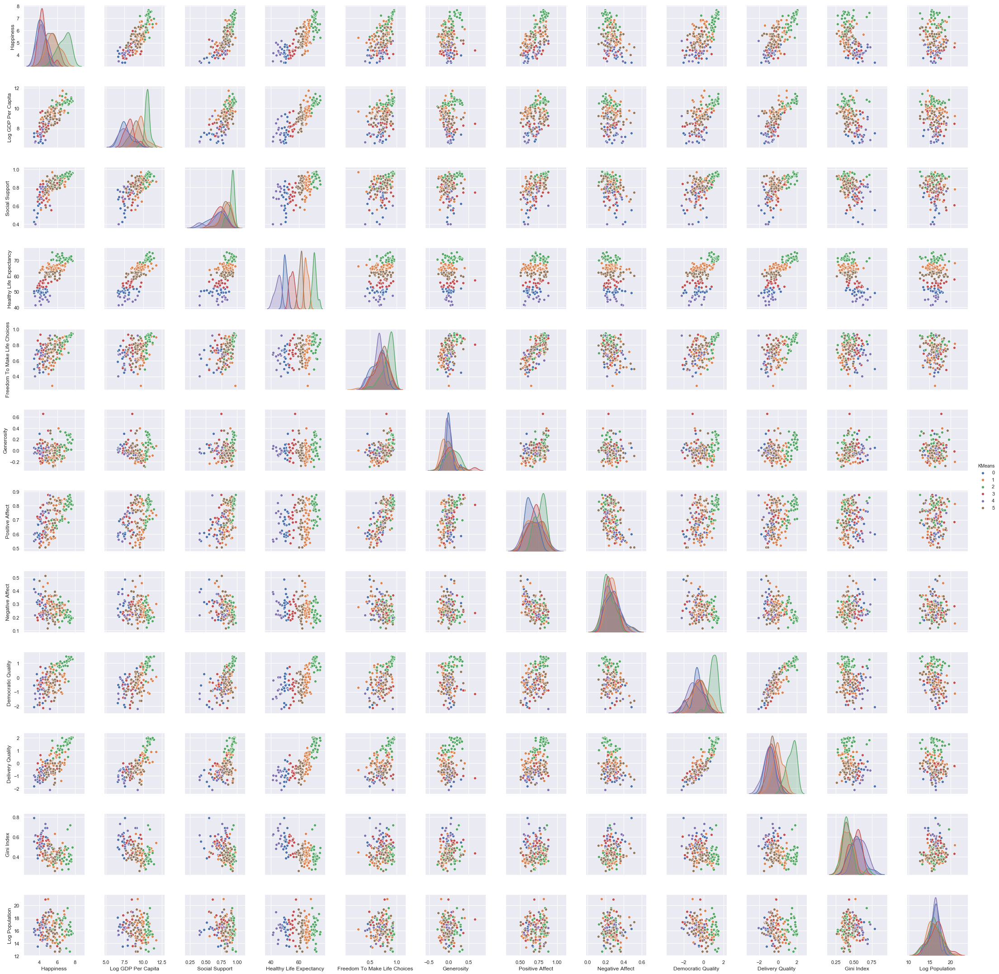

In [54]:
plot_pairplot(X_labelled, X, "KMeans")

### DBScan Clustering

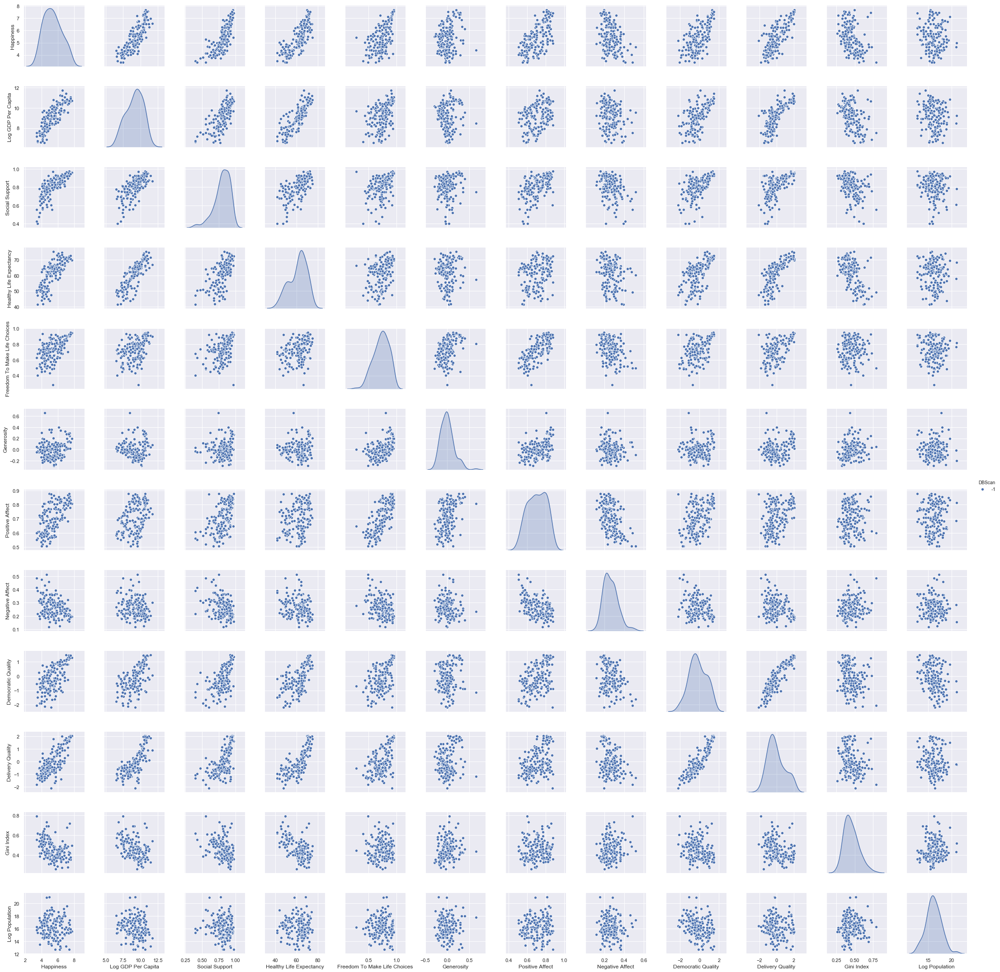

In [55]:
plot_pairplot(X_labelled, X, "DBScan")

### Gaussian Mixture Clustering

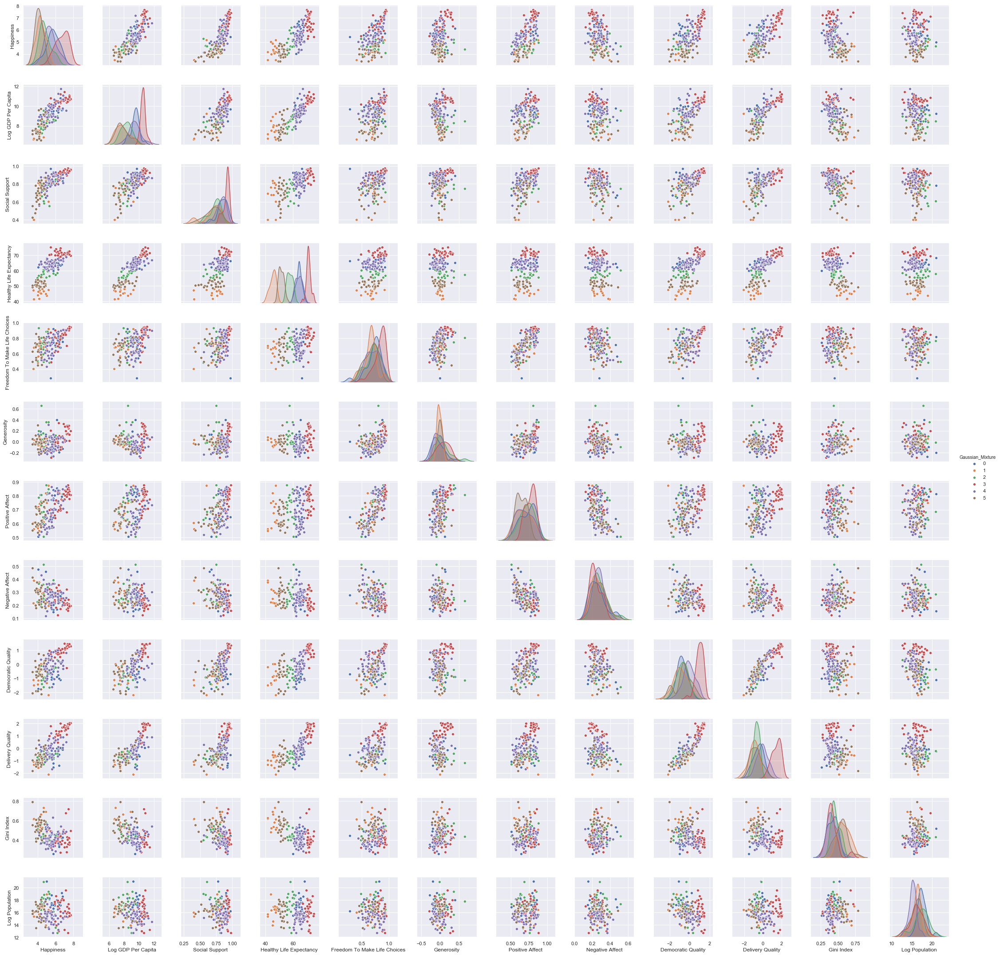

In [56]:
plot_pairplot(X_labelled, X, "Gaussian_Mixture")

## Silhouette Plot
[Back](#Clustering)

For n_clusters = 2, the average silhouette_score is : 0.5996861435899412
For n_clusters = 3, the average silhouette_score is : 0.4903712803286172
For n_clusters = 4, the average silhouette_score is : 0.43479414265411137
For n_clusters = 5, the average silhouette_score is : 0.3919137961041291
For n_clusters = 6, the average silhouette_score is : 0.3714456899768711


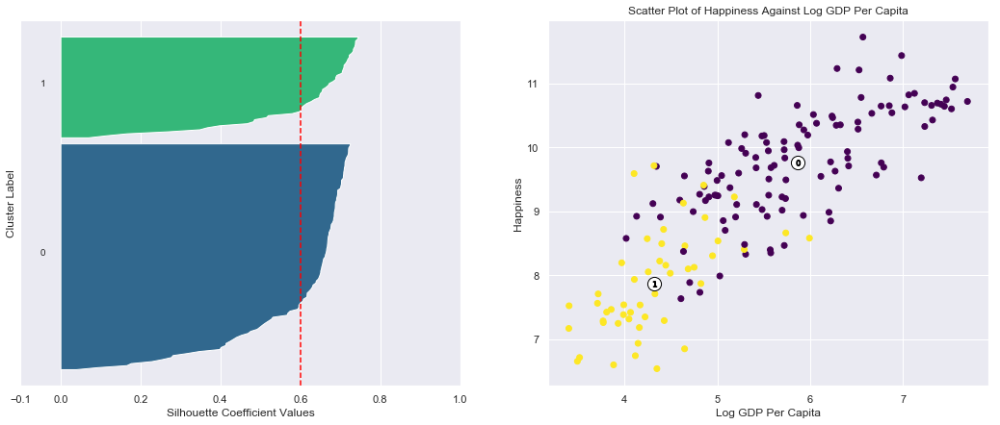

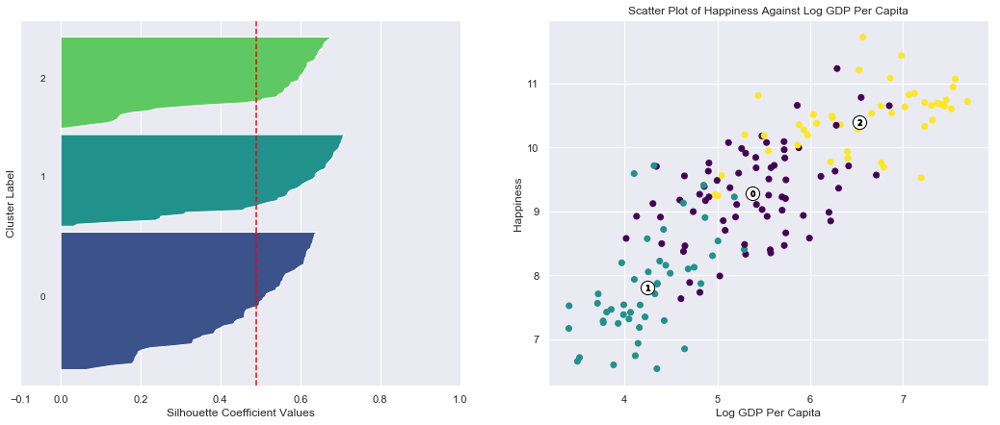

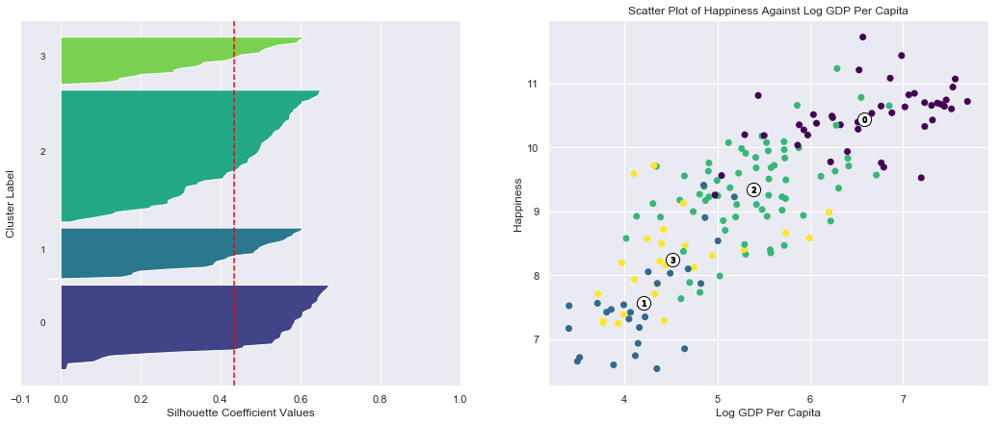

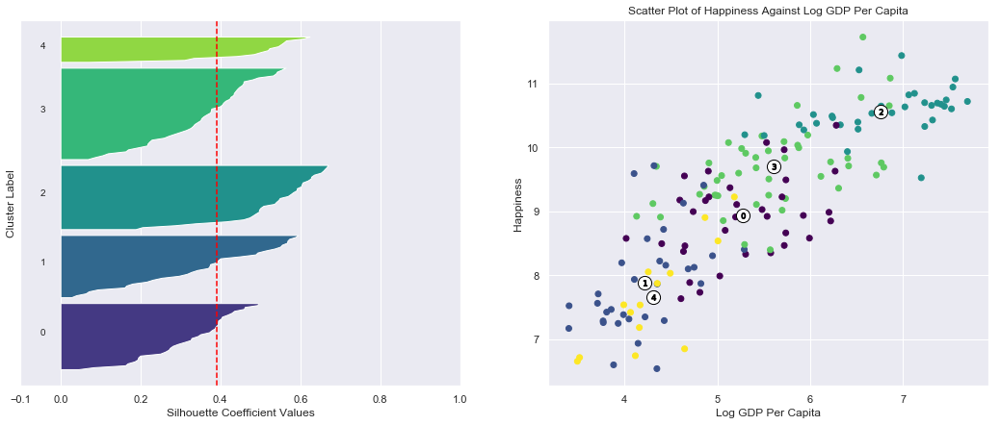

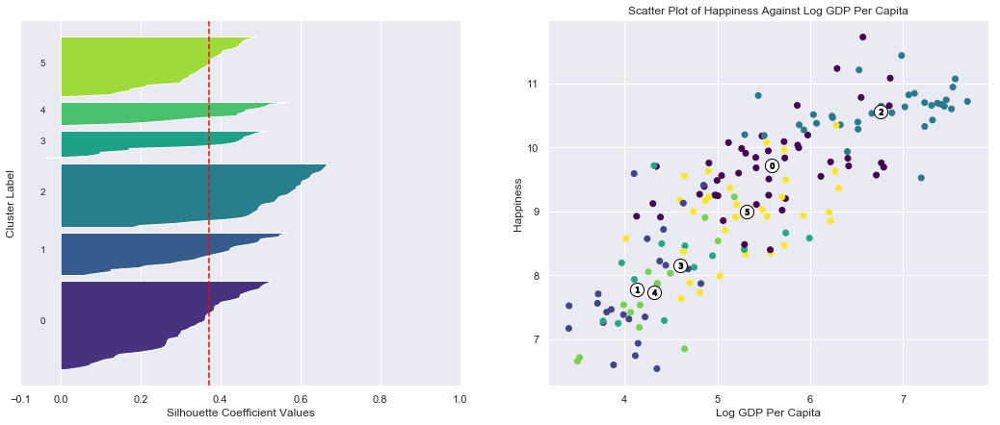

In [57]:
from sklearn.metrics import silhouette_score, silhouette_samples
import matplotlib.cm as cm

range_n_clusters = range(2, 7)

for n_clusters in range_n_clusters:
    
    # Create a subplot with 1 row & 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (18, 7))
    
    
    # ax1: Silhouette plot
    # Fit the KMean model
    clusterer = cluster.KMeans(n_clusters = n_clusters, random_state = 10)
    cluster_labels = clusterer.fit_predict(X)

    # silhouete_score returns average for all clusters
    # Gives a perspective into the density & separation of formed clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters = " + str(n_clusters) +  ", the average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)
    y_lower = 0
    
    for i in range(n_clusters):
        # Aggregate the silhouette scores for cluster i & sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()
        
        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i
    
        color = sb.color_palette(palette = "viridis", n_colors = n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values, facecolor = color[i])

        # Label silhouette plot with cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute new y_lower for next cluster (+2 for space)
        y_lower = y_upper + 2

    
    # Vertical line for average silhouette score of all  values
    ax1.axvline(x = silhouette_avg, color = "red", linestyle = "--")

    # Label axes
    ax1.set_xlabel("Silhouette Coefficient Values")
    ax1.set_ylabel("Cluster Label")
    ax1.set_yticks([])
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    
    # ax2: Scatter plot of Happiness against Log GDP Per Capita
    ax2.scatter(X["Happiness"], X["Log GDP Per Capita"], c = cluster_labels, cmap = "viridis")

    # Labeling cluster centres
    centers = clusterer.cluster_centers_
    ax2.scatter(centers[:, 0], centers[:, 1], marker = 'o', c = "white", s = 200, edgecolor = 'black')
    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker = '$%d$' % i, edgecolor='black')
    
    # Label Axes
    ax2.set_title("Scatter Plot of Happiness Against Log GDP Per Capita")
    ax2.set_xlabel("Log GDP Per Capita")
    ax2.set_ylabel("Happiness")

# Regression
[Back](#Forecasting-Happiness)

- [Train-Test Split](#Train-Test-Split)
- [Linear Regression](#Linear-Regression)
- [Random Forest Regression](#Random-Forest-Regression)
- [K-Nearest Neighbour Regression](#K-Nearest-Neighbour-Regression)
- [Multi-Layer Perceptron Regression](#Multi-Layer-Perceptron-Regression)
- [Analysis of Regression](#Analysis-of-Regression)

## Train-Test Split
[Back](#Regression)

- Train: 2005 - 2016
- Test: 2017

In [58]:
data_2017 = []
for i in range(len(happiness_data)):
    if happiness_data.iloc[i]['Year'] == 2017:
        data_2017.append(happiness_data.iloc[i])

data_2017 = pd.DataFrame(data_2017)
print(len(data_2017['Country'].unique()))

data_previous = []
for i in range(len(happiness_data)):
    if happiness_data.iloc[i]['Year'] != 2017:
        data_previous.append(happiness_data.iloc[i])
data_previous = pd.DataFrame(data_previous)

141


### Dealing with Missing Countries

In [59]:
# Countries in previous years, but not in 2017
country_2017 = list(data_2017['Country'])
country_previous = list(data_previous['Country'].unique())

for i in country_previous:
    if i not in country_2017:
        print(i)

Angola
Belize
Bhutan
Burundi
Canada
Comoros
Cuba
Djibouti
Guyana
Lesotho
Malaysia
North Cyprus
Oman
Paraguay
Qatar
Rwanda
Somalia
Somaliland region
Sudan
Suriname
Swaziland
Syria
Venezuela


In [60]:
# Remove them from data_previous
extra_country = ['Angola', 'Belize', 'Bhutan', 'Burundi', 'Canada', 'Comoros', 'Cuba', 'Djibouti', 'Guyana','Lesotho', 
         'Malaysia', 'North Cyprus', 'Oman', 'Paraguay', 'Qatar', 'Rwanda', 
         'Somalia', 'Somaliland region', 'Sudan', 'Suriname', 'Swaziland', 'Syria', 'Venezuela']

for country in extra_country:
    data_previous = data_previous[data_previous['Country'] != country]

### Extract Predictors & Response Variables

In [61]:
X_train = pd.DataFrame(data_previous.drop(columns = ['Happiness', 'Region', 'Population', 'Country', 'Year'])) # Predictors
y_train = pd.DataFrame(data_previous['Happiness']) # Response
X_test = pd.DataFrame(data_2017.drop(columns = ['Happiness', 'Region', 'Population', 'Country', 'Year'])) # Predictors
y_test = pd.DataFrame(data_2017['Happiness']) # Response

## Linear Regression
[Back](#Regression)

Intercept of Regression 	: b =  [-1.98027265]
Coefficients of Regression 	: a =  [[ 0.30328312  1.83033796  0.01893996  0.52903134  0.47757978  2.19105346
   0.12181986 -0.05374114  0.19012658 -0.80082036  0.02001042]]

Goodness of Fit of Model 	Train Dataset
Explained Variance (R^2) 	: 0.7619828868659126
Mean Squared Error (MSE) 	: 0.2927585052943093

Goodness of Fit of Model 	Test Dataset
Explained Variance (R^2) 	: 0.7561405367891737
Mean Squared Error (MSE) 	: 0.3040280427204786


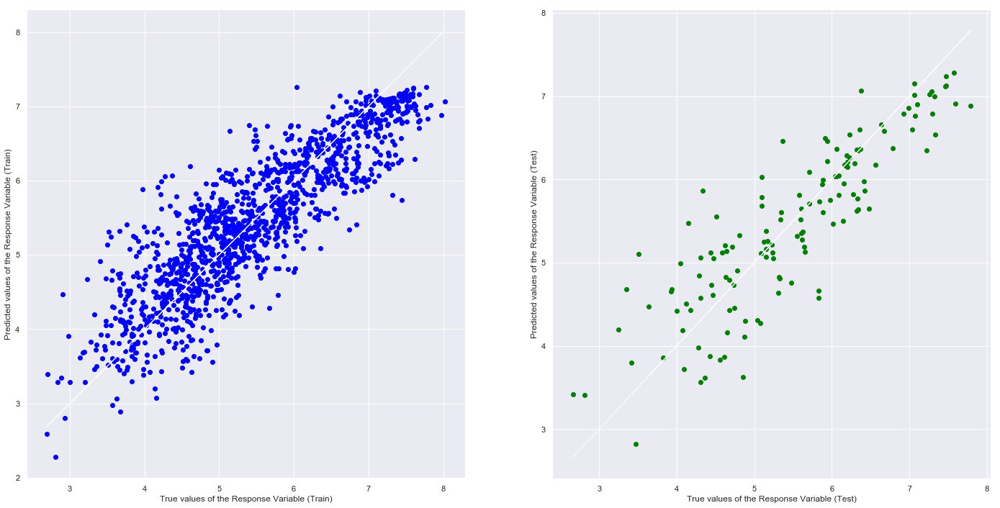

In [62]:
# Fit the model
from sklearn.linear_model import LinearRegression
linreg = LinearRegression(normalize = False)
linreg.fit(X_train, y_train)

# Coefficients
print('Intercept of Regression \t: b = ', linreg.intercept_)
print('Coefficients of Regression \t: a = ', linreg.coef_)
print()

# Scatter plot
y_train_pred = linreg.predict(X_train)
y_test_pred = linreg.predict(X_test)

f, axes = plt.subplots(1, 2, figsize=(24, 12))

axes[0].scatter(y_train, y_train_pred, color = "blue")
axes[0].plot(y_train, y_train, 'w-', linewidth = 1)
axes[0].set_xlabel("True values of the Response Variable (Train)")
axes[0].set_ylabel("Predicted values of the Response Variable (Train)")

axes[1].scatter(y_test, y_test_pred, color = "green")
axes[1].plot(y_test, y_test, 'w-', linewidth = 1)
axes[1].set_xlabel("True values of the Response Variable (Test)")
axes[1].set_ylabel("Predicted values of the Response Variable (Test)")

# Goodness of fit
from sklearn.metrics import mean_squared_error
print("Goodness of Fit of Model \tTrain Dataset")
print("Explained Variance (R^2) \t:", linreg.score(X_train, y_train))
print("Mean Squared Error (MSE) \t:", mean_squared_error(y_train, y_train_pred))
print()
print("Goodness of Fit of Model \tTest Dataset")
print("Explained Variance (R^2) \t:", linreg.score(X_test, y_test))
print("Mean Squared Error (MSE) \t:", mean_squared_error(y_test, y_test_pred))

## Random Forest Regression
[Back](#Regression)

Goodness of Fit of Model 	Train Dataset
Explained Variance (R^2) 	: 0.983767215274919
Mean Squared Error (MSE) 	: 0.019966151720367302

Goodness of Fit of Model 	Test Dataset
Explained Variance (R^2) 	: 0.8557667295485262
Mean Squared Error (MSE) 	: 0.17982061607600647


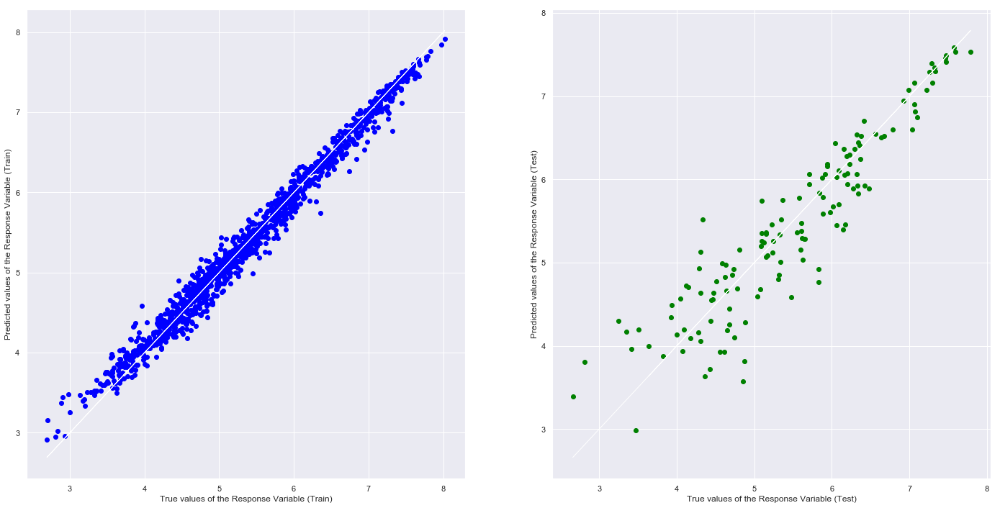

In [63]:
# Fit the model
from sklearn.ensemble import RandomForestRegressor
randForest = RandomForestRegressor(n_estimators = 40, min_samples_split = 2)
randForest.fit(X_train, y_train["Happiness"])

# Scatter plot
y_train_pred = randForest.predict(X_train)
y_test_pred = randForest.predict(X_test)

f, axes = plt.subplots(1, 2, figsize=(24, 12))

axes[0].scatter(y_train, y_train_pred, color = "blue")
axes[0].plot(y_train, y_train, 'w-', linewidth = 1)
axes[0].set_xlabel("True values of the Response Variable (Train)")
axes[0].set_ylabel("Predicted values of the Response Variable (Train)")

axes[1].scatter(y_test, y_test_pred, color = "green")
axes[1].plot(y_test, y_test, 'w-', linewidth = 1)
axes[1].set_xlabel("True values of the Response Variable (Test)")
axes[1].set_ylabel("Predicted values of the Response Variable (Test)")

# Goodness of fit
from sklearn.metrics import mean_squared_error
print("Goodness of Fit of Model \tTrain Dataset")
print("Explained Variance (R^2) \t:", randForest.score(X_train, y_train))
print("Mean Squared Error (MSE) \t:", mean_squared_error(y_train, y_train_pred))
print()
print("Goodness of Fit of Model \tTest Dataset")
print("Explained Variance (R^2) \t:", randForest.score(X_test, y_test))
print("Mean Squared Error (MSE) \t:", mean_squared_error(y_test, y_test_pred))

## K-Nearest Neighbour Regression
[Back](#Regression)

Goodness of Fit of Model 	Train Dataset
Explained Variance (R^2) 	: 0.949558432545443
Mean Squared Error (MSE) 	: 0.062042588863679915

Goodness of Fit of Model 	Test Dataset
Explained Variance (R^2) 	: 0.8423841610772841
Mean Squared Error (MSE) 	: 0.1965051279063593


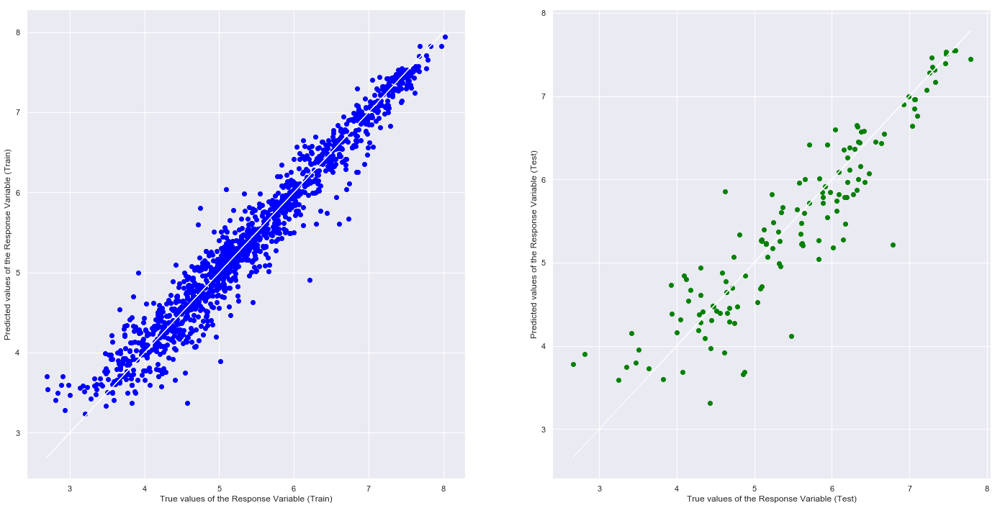

In [64]:
# Fit the model
from sklearn.neighbors import KNeighborsRegressor
neigh = KNeighborsRegressor(n_neighbors = 3, algorithm = 'ball_tree')
neigh.fit(X_train, y_train) 

# Scatter plot
y_train_pred = neigh.predict(X_train)
y_test_pred = neigh.predict(X_test)

f, axes = plt.subplots(1, 2, figsize=(24, 12))

axes[0].scatter(y_train, y_train_pred, color = "blue")
axes[0].plot(y_train, y_train, 'w-', linewidth = 1)
axes[0].set_xlabel("True values of the Response Variable (Train)")
axes[0].set_ylabel("Predicted values of the Response Variable (Train)")

axes[1].scatter(y_test, y_test_pred, color = "green")
axes[1].plot(y_test, y_test, 'w-', linewidth = 1)
axes[1].set_xlabel("True values of the Response Variable (Test)")
axes[1].set_ylabel("Predicted values of the Response Variable (Test)")

# Goodness of fit
from sklearn.metrics import mean_squared_error
print("Goodness of Fit of Model \tTrain Dataset")
print("Explained Variance (R^2) \t:", neigh.score(X_train, y_train))
print("Mean Squared Error (MSE) \t:", mean_squared_error(y_train, y_train_pred))
print()
print("Goodness of Fit of Model \tTest Dataset")
print("Explained Variance (R^2) \t:", neigh.score(X_test, y_test))
print("Mean Squared Error (MSE) \t:", mean_squared_error(y_test, y_test_pred))

## Multi-Layer Perceptron Regression
[Back](#Regression)

/anaconda3/lib/python3.6/site-packages/sklearn/neural_network/multilayer_perceptron.py:562: ConvergenceWarning:

Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.



[(11, 128), (128, 256), (256, 256), (256, 256), (256, 1)]

Goodness of Fit of Model 	Train Dataset
Explained Variance (R^2) 	: 0.8700404352602567
Mean Squared Error (MSE) 	: 0.1598488756582498

Goodness of Fit of Model 	Test Dataset
Explained Variance (R^2) 	: 0.84072138197034
Mean Squared Error (MSE) 	: 0.19857817223568133


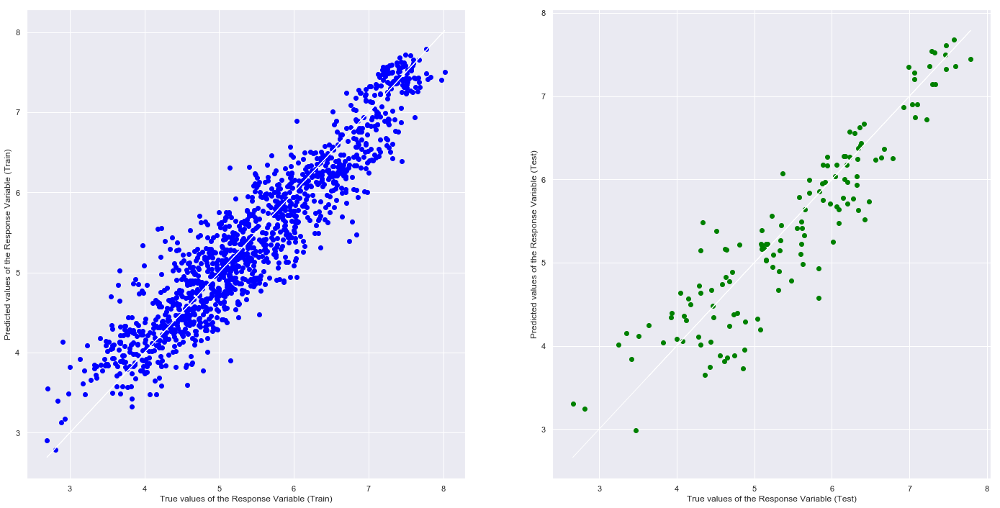

In [65]:
# Fit the model
from sklearn.neural_network import MLPRegressor
mlpModel = MLPRegressor(solver='adam',
                        alpha = 1e-5,
                        hidden_layer_sizes = (128, 256, 256, 256),
                        random_state=1,
                        max_iter = 500,
                        n_iter_no_change = 50)
mlpModel.fit(X_train, y_train["Happiness"])

# Coefficients
print([coef.shape for coef in mlpModel.coefs_])
print()

# Scatter plot
y_train_pred = mlpModel.predict(X_train)
y_test_pred = mlpModel.predict(X_test)

f, axes = plt.subplots(1, 2, figsize=(24, 12))

axes[0].scatter(y_train, y_train_pred, color = "blue")
axes[0].plot(y_train, y_train, 'w-', linewidth = 1)
axes[0].set_xlabel("True values of the Response Variable (Train)")
axes[0].set_ylabel("Predicted values of the Response Variable (Train)")

axes[1].scatter(y_test, y_test_pred, color = "green")
axes[1].plot(y_test, y_test, 'w-', linewidth = 1)
axes[1].set_xlabel("True values of the Response Variable (Test)")
axes[1].set_ylabel("Predicted values of the Response Variable (Test)")

# Goodness of fit
from sklearn.metrics import mean_squared_error
print("Goodness of Fit of Model \tTrain Dataset")
print("Explained Variance (R^2) \t:", mlpModel.score(X_train, y_train))
print("Mean Squared Error (MSE) \t:", mean_squared_error(y_train, y_train_pred))
print()
print("Goodness of Fit of Model \tTest Dataset")
print("Explained Variance (R^2) \t:", mlpModel.score(X_test, y_test))
print("Mean Squared Error (MSE) \t:", mean_squared_error(y_test, y_test_pred))

## Analysis of Regression
[Back](#Regression)

**Ranking Based on Test $R^2$**
1. Random Forest Regression (0.84)
2. K-Nearest Neighbour Regression (0.84)
3. Multi-Layer Perceptron Regression (0.82)
4. Linear Regression (0.76)

In [66]:
# Regression Models
models = [
    {
        "name": "Linear Regression",
        "model": linreg
    },
    {
        "name": "Random Forest Regression",
        "model": randForest
    },
    {
        "name": "K-Nearest Neighbours Regression",
        "model": neigh
    },
    {
        "name": "Multi-Layer",
        "model": mlpModel
    }
]

# Forecasting
[Back](#Forecasting-Happiness)

- [Forecast Using Happiness Values from Previous Years](#Forecast-Using-Happiness-Values-from-Previous-Years)
- [Forecast Using Supporting Factors from Previous Years](#Forecast-Using-Supporting-Factors-from-Previous-Years)
- [Analysis of Forecasting](#Analysis-of-Forecasting)

## Forecast Using Happiness Values from Previous Years
[Back](#Forecasting)

### Mean Value

In [67]:
# Forecast
y_test_pred = pd.DataFrame(columns = ['Happiness'], index = country_2017)
happiness_previous = pd.DataFrame(data_previous[['Country', 'Year', 'Happiness']])

for country in country_2017:
    happiness_before = happiness_previous[happiness_previous['Country'] == country]
    mean = happiness_before['Happiness'].mean()
    y_test_pred['Happiness'][country] = mean

Explained Variance (R^2)	 0.8178224081215243
Mean Squared Error (MSE)	 0.22712711640170696


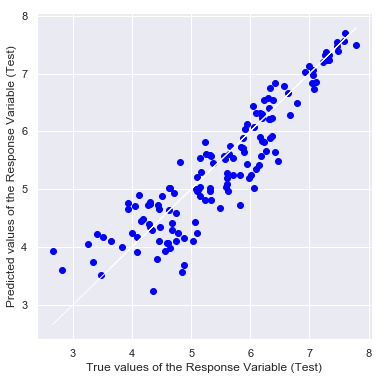

In [68]:
# Scatter plot
f, axes = plt.subplots(1, 1, figsize=(6, 6))

axes.scatter(y_test, y_test_pred, color = "blue")
axes.plot(y_test, y_test, 'w-', linewidth = 1)
axes.set_xlabel("True values of the Response Variable (Test)")
axes.set_ylabel("Predicted values of the Response Variable (Test)")

# Goodness of fit
from sklearn.metrics import r2_score, mean_squared_error
print('Explained Variance (R^2)\t', r2_score(y_test, y_test_pred))
print('Mean Squared Error (MSE)\t', mean_squared_error(y_test, y_test_pred))

### Weighted Moving Average

In [69]:
# Forecast
y_test_pred = pd.DataFrame(columns = ['Happiness'], index = country_2017)
happiness_previous = pd.DataFrame(data_previous[['Country', 'Year', 'Happiness']])
for country in country_2017:
    happiness_before = happiness_previous[happiness_previous['Country'] == country]
    number_of_years = len(happiness_before)
    
    happiness_country = pd.DataFrame(happiness_before[['Year', 'Happiness']])
    happiness_country = happiness_country.reset_index()
    sum = 0
    for i in range(1, number_of_years+1):
        sum += i * happiness_country['Happiness'][i-1]
    
    denominator = (1+number_of_years)*number_of_years*0.5
    weighted_mean = sum/denominator
    y_test_pred['Happiness'][country] = weighted_mean

Explained Variance (R^2)	 0.8460137068667434
Mean Squared Error (MSE)	 0.19198004740382552


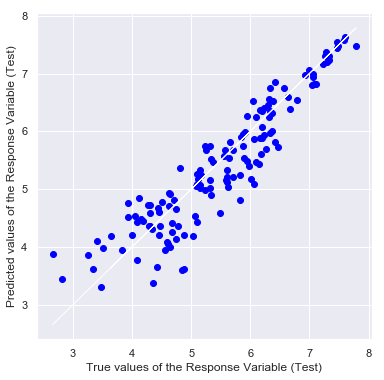

In [70]:
# Scatter plot
f, axes = plt.subplots(1, 1, figsize=(6, 6))

axes.scatter(y_test, y_test_pred, color = "blue")
axes.plot(y_test, y_test, 'w-', linewidth = 1)
axes.set_xlabel("True values of the Response Variable (Test)")
axes.set_ylabel("Predicted values of the Response Variable (Test)")

# Goodness of fit
print('Explained Variance (R^2)\t', r2_score(y_test, y_test_pred))
print('Mean Squared Error (MSE)\t', mean_squared_error(y_test, y_test_pred))

### Vector Autoregression (VAR) Model

In [71]:
# Forecast
y_test_pred = pd.DataFrame(columns = ['Happiness'], index = country_2017)
happiness_previous = pd.DataFrame(data_previous[['Country', 'Year', 'Happiness']])

import warnings
warnings.filterwarnings(action = 'ignore')

from statsmodels.tsa.vector_ar.var_model import VAR

for country in country_2017:
    #previous_country = variable_previous[variable_previous['Country'] == country]
    happiness_before = pd.DataFrame(happiness_previous[happiness_previous['Country'] == country])
    happiness_before = happiness_before[['Year', 'Happiness']]
    model = VAR(happiness_before)
    model_fit = model.fit(trend = "nc")
    pred = model_fit.forecast(model_fit.y, steps=1)
    y_test_pred['Happiness'][country] = pred[0][1]

Explained Variance (R^2)	 0.6495097808076591
Mean Squared Error (MSE)	 0.43696830104802836


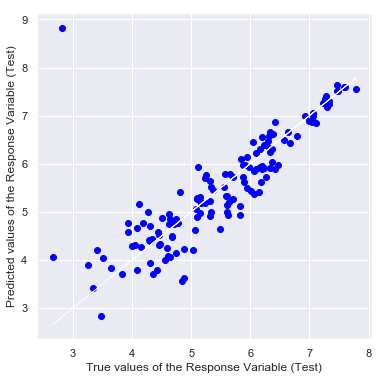

In [72]:
# Scatter plot
f, axes = plt.subplots(1, 1, figsize=(6, 6))

axes.scatter(y_test, y_test_pred, color = "blue")
axes.plot(y_test, y_test, 'w-', linewidth = 1)
axes.set_xlabel("True values of the Response Variable (Test)")
axes.set_ylabel("Predicted values of the Response Variable (Test)")

# Goodness of fit
print('Explained Variance (R^2)\t', r2_score(y_test, y_test_pred))
print('Mean Squared Error (MSE)\t', mean_squared_error(y_test, y_test_pred))

## Forecast Using Supporting Factors from Previous Years
[Back](#Forecasting)
- Forecast supporting factors using a time series
- Predict happiness with the supporting factors using regression

### Mean Value

In [73]:
# Forescast
variable_previous = pd.DataFrame(data_previous.drop(columns = ['Happiness', 'Region', 'Population']))
variable_2017 = pd.DataFrame(data_2017.drop(columns = ['Happiness', 'Region', 'Population']))
variable_mean = pd.DataFrame(columns = ['Country', 'Log GDP Per Capita', 'Social Support', 'Healthy Life Expectancy',
                                       'Freedom To Make Life Choices', 'Generosity', 'Positive Affect', 
                                       'Negative Affect', 'Democratic Quality', 'Delivery Quality', 'Gini Index',
                                       'Log Population'])

variable_mean['Country'] = variable_previous['Country'].unique()
for var in variable_previous.columns[2: 13]: # loop through the variables
    mean = variable_previous.groupby('Country')[var].mean()
    mean = pd.DataFrame(mean).reset_index()
    variable_mean[var] = mean[var]
    
extra = ['Angola', 'Belize', 'Bhutan', 'Burundi', 'Canada', 'Comoros', 'Cuba', 'Djibouti', 'Guyana','Lesotho', 
         'Malaysia', 'North Cyprus', 'Oman', 'Paraguay', 'Qatar', 'Rwanda', 
         'Somalia', 'Somaliland region', 'Sudan', 'Suriname', 'Swaziland', 'Syria', 'Venezuela']

for var in extra:
    variable_mean = variable_mean[variable_mean['Country'] != var]

Goodness of Fit of Linear Regression
Explained Variance (R^2) 	: 0.7236592526129211
Mean Squared Error (MSE) 	: 0.34452358520683357

Goodness of Fit of Random Forest Regression
Explained Variance (R^2) 	: 0.8056626438666386
Mean Squared Error (MSE) 	: 0.2422871158443336

Goodness of Fit of K-Nearest Neighbours Regression
Explained Variance (R^2) 	: 0.7823946223893304
Mean Squared Error (MSE) 	: 0.2712961644766115

Goodness of Fit of Multi-Layer
Explained Variance (R^2) 	: 0.7951210638934659
Mean Squared Error (MSE) 	: 0.25542966887150187



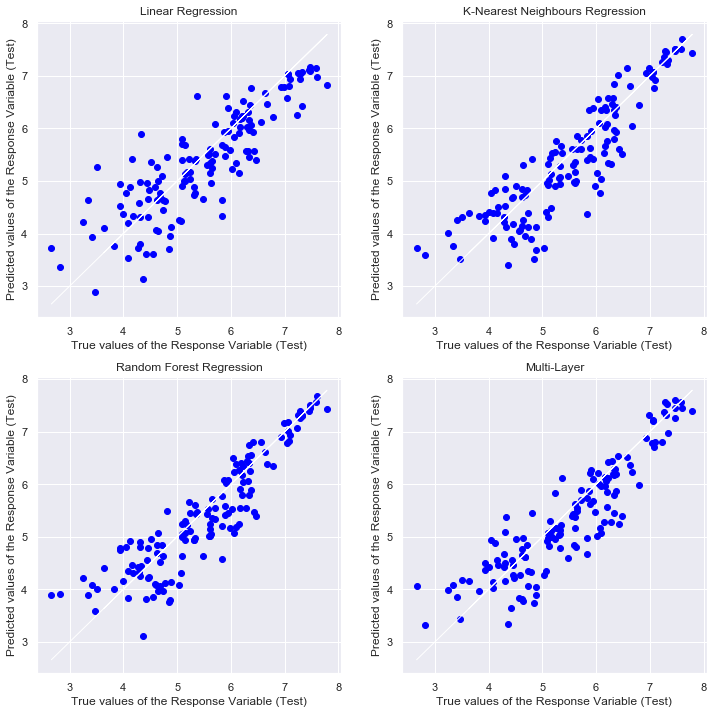

In [74]:
# Regression
X_test_pred = pd.DataFrame(variable_mean.drop(columns = ['Country']))

f, axes = plt.subplots(2, 2, figsize = (12, 12))

for i in range(len(models)):
    name = models[i]["name"]
    model = models[i]["model"]
    
    # Predict
    y_test_pred = model.predict(X_test_pred)
    
    # Scatter plot
    ax = axes[i % 2, i // 2]
    ax.scatter(y_test, y_test_pred, color = "blue")
    ax.plot(y_test, y_test, 'w-', linewidth = 1)
    ax.set_title(name)
    ax.set_xlabel("True values of the Response Variable (Test)")
    ax.set_ylabel("Predicted values of the Response Variable (Test)")
    
    # Goodness of Fit
    print("Goodness of Fit of", name)
    print("Explained Variance (R^2) \t:", model.score(X_test_pred, y_test))
    print("Mean Squared Error (MSE) \t:", mean_squared_error(y_test, y_test_pred))
    print()

### Weighted Moving Average

In [75]:
# Forecast
variable_previous = pd.DataFrame(data_previous.drop(columns = ['Happiness', 'Region', 'Population']))
variable_2017 = pd.DataFrame(data_2017.drop(columns = ['Happiness', 'Region', 'Population']))

variable_list = ['Log GDP Per Capita', 'Social Support', 'Healthy Life Expectancy', 'Freedom To Make Life Choices', 'Generosity',
                'Positive Affect', 'Negative Affect', 'Democratic Quality', 'Delivery Quality', 'Gini Index', 'Log Population']
weighted = pd.DataFrame(columns = variable_list, index = country_2017)

for country in country_2017:
    previous_country = variable_previous[variable_previous['Country'] == country]
    number_of_years = len(previous_country)
    
    for variable in variable_list:
        variable_previous_country = previous_country[['Year', variable]]
        variable_previous_country = variable_previous_country.reset_index()
        sum = 0
        for i in range(1, number_of_years+1):
            sum += i*variable_previous_country[variable][i-1]
        denominator = (1+number_of_years)*number_of_years*0.5
        weighted_mean = sum/denominator
        
        weighted[variable][country] = weighted_mean

Goodness of Fit of Linear Regression
Explained Variance (R^2) 	: 0.7297127285886107
Mean Squared Error (MSE) 	: 0.33697650694990655

Goodness of Fit of Random Forest Regression
Explained Variance (R^2) 	: 0.8319055294548362
Mean Squared Error (MSE) 	: 0.20956920104346588

Goodness of Fit of K-Nearest Neighbours Regression
Explained Variance (R^2) 	: 0.7883421271202993
Mean Squared Error (MSE) 	: 0.26388120424247047

Goodness of Fit of Multi-Layer
Explained Variance (R^2) 	: 0.814593351662079
Mean Squared Error (MSE) 	: 0.23115289297922015



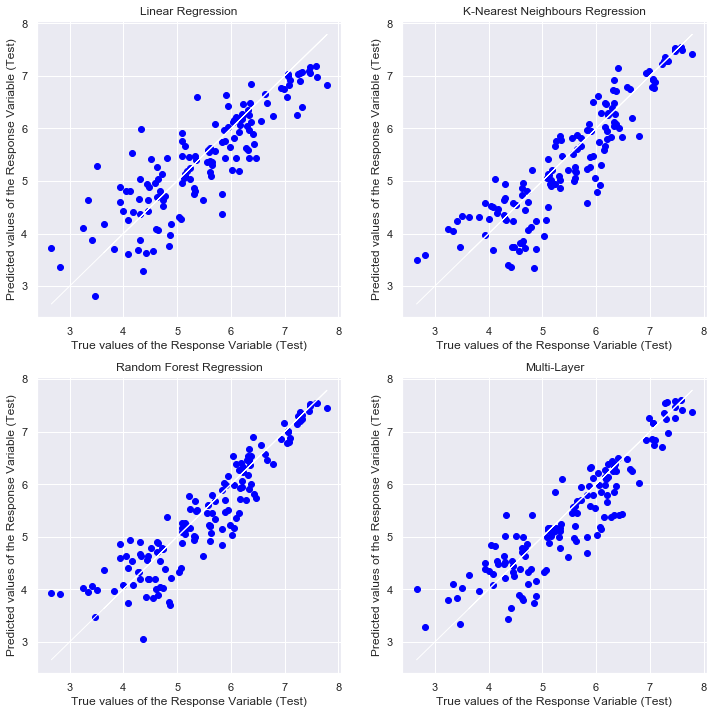

In [76]:
# Regression
X_test_pred = weighted

f, axes = plt.subplots(2, 2, figsize = (12, 12))

for i in range(len(models)):
    name = models[i]["name"]
    model = models[i]["model"]
    
    # Predict
    y_test_pred = model.predict(X_test_pred)
    
    # Scatter plot
    ax = axes[i % 2, i // 2]
    ax.scatter(y_test, y_test_pred, color = "blue")
    ax.plot(y_test, y_test, 'w-', linewidth = 1)
    ax.set_title(name)
    ax.set_xlabel("True values of the Response Variable (Test)")
    ax.set_ylabel("Predicted values of the Response Variable (Test)")
    
    # Goodness of Fit
    print("Goodness of Fit of", name)
    print("Explained Variance (R^2) \t:", model.score(X_test_pred, y_test))
    print("Mean Squared Error (MSE) \t:", mean_squared_error(y_test, y_test_pred))
    print()

### Vector Autoregression (VAR) Model

#### Uni-Variate Forecasting

In [77]:
# Forecast
pred = pd.DataFrame(columns = variable_list, index = country_2017)
variable_previous = pd.DataFrame(data_previous.drop(columns = ['Happiness', 'Region', 'Population']))
variable_2017 = pd.DataFrame(data_2017.drop(columns = ['Happiness', 'Region', 'Population']))

for country in country_2017:
    previous_country = variable_previous[variable_previous['Country'] == country]
    
    for variable in variable_list:
        variable_previous_country = previous_country[['Year', variable]]
        model = VAR(variable_previous_country)
        model_fit = model.fit(trend = "nc")
        y_pred_country_variable = model_fit.forecast(model_fit.y, steps=1)
        #country_pred.append(y_pred_country_variable[0][1]) 
        # each time for a country, a list of all predicted variables is generated
        pred[variable][country] = y_pred_country_variable[0][1]

Goodness of Fit of Linear Regression
Explained Variance (R^2) 	: 0.5121513483047078
Mean Squared Error (MSE) 	: 0.6082178184346937

Goodness of Fit of Random Forest Regression
Explained Variance (R^2) 	: 0.8538472318885608
Mean Squared Error (MSE) 	: 0.18221372032089403

Goodness of Fit of K-Nearest Neighbours Regression
Explained Variance (R^2) 	: 0.8474385934571929
Mean Squared Error (MSE) 	: 0.19020359191799305

Goodness of Fit of Multi-Layer
Explained Variance (R^2) 	: 0.75544138726516
Mean Squared Error (MSE) 	: 0.3048996966581857



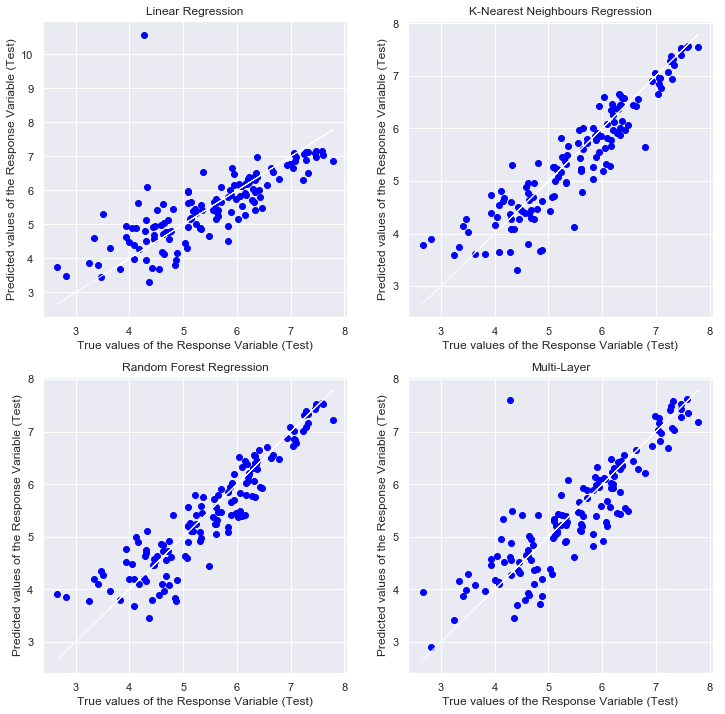

In [78]:
# Regression
X_test_pred = pred

f, axes = plt.subplots(2, 2, figsize = (12, 12))

for i in range(len(models)):
    name = models[i]["name"]
    model = models[i]["model"]
    
    # Predict
    y_test_pred = model.predict(X_test_pred)
    
    # Scatter plot
    ax = axes[i % 2, i // 2]
    ax.scatter(y_test, y_test_pred, color = "blue")
    ax.plot(y_test, y_test, 'w-', linewidth = 1)
    ax.set_title(name)
    ax.set_xlabel("True values of the Response Variable (Test)")
    ax.set_ylabel("Predicted values of the Response Variable (Test)")
    
    # Goodness of Fit
    print("Goodness of Fit of", name)
    print("Explained Variance (R^2) \t:", model.score(X_test_pred, y_test))
    print("Mean Squared Error (MSE) \t:", mean_squared_error(y_test, y_test_pred))
    print()

#### Multi-Variate Forecasting

In [79]:
pred = pd.DataFrame(columns = variable_list, index = country_2017)
variable_previous = pd.DataFrame(data_previous.drop(columns = ['Happiness', 'Region', 'Population']))
variable_2017 = pd.DataFrame(data_2017.drop(columns = ['Happiness', 'Region', 'Population']))

for country in country_2017:
    previous_country = variable_previous[variable_previous['Country'] == country]
    data = previous_country.drop(['Year'], axis=1)
    data.index=previous_country.Year
    data = pd.DataFrame(data.drop(columns = 'Country'))
    model = VAR(endog=data)
    model_fit = model.fit(trend = "nc")
    prediction = model_fit.forecast(model_fit.y, steps = 1)
    for i in range(len(variable_list)):
        pred[variable_list[i]][country] = prediction[0][i]

Goodness of Fit of Linear Regression
Explained Variance (R^2) 	: 0.3726939996220822
Mean Squared Error (MSE) 	: 0.7820841273517701

Goodness of Fit of Random Forest Regression
Explained Variance (R^2) 	: 0.721159444179974
Mean Squared Error (MSE) 	: 0.3476401830006538

Goodness of Fit of K-Nearest Neighbours Regression
Explained Variance (R^2) 	: 0.8138767233894925
Mean Squared Error (MSE) 	: 0.2320463382784261

Goodness of Fit of Multi-Layer
Explained Variance (R^2) 	: 0.5530707181450609
Mean Squared Error (MSE) 	: 0.5572022221641378



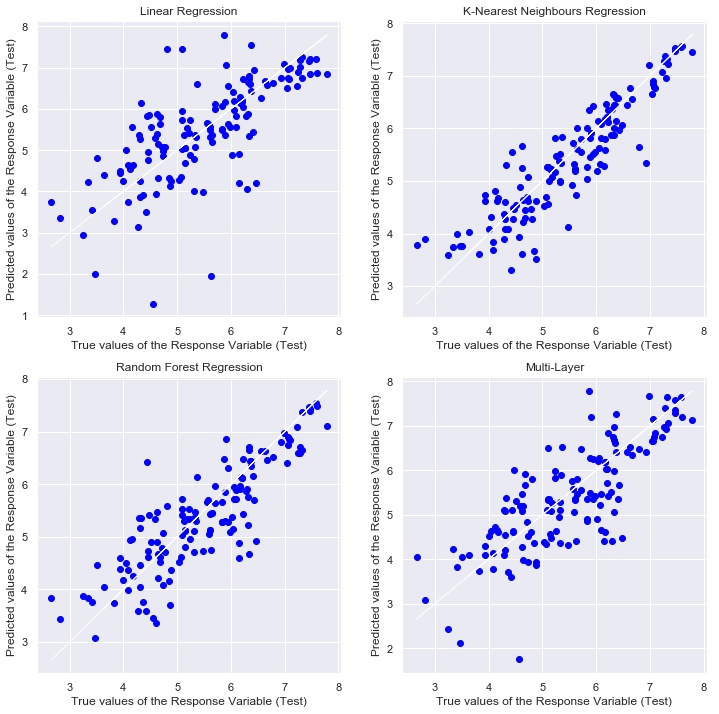

In [80]:
# Regression
X_test_pred = pred

f, axes = plt.subplots(2, 2, figsize = (12, 12))

for i in range(len(models)):
    name = models[i]["name"]
    model = models[i]["model"]
    
    # Predict
    y_test_pred = model.predict(X_test_pred)
    
    # Scatter plot
    ax = axes[i % 2, i // 2]
    ax.scatter(y_test, y_test_pred, color = "blue")
    ax.plot(y_test, y_test, 'w-', linewidth = 1)
    ax.set_title(name)
    ax.set_xlabel("True values of the Response Variable (Test)")
    ax.set_ylabel("Predicted values of the Response Variable (Test)")
    
    # Goodness of Fit
    print("Goodness of Fit of", name)
    print("Explained Variance (R^2) \t:", model.score(X_test_pred, y_test))
    print("Mean Squared Error (MSE) \t:", mean_squared_error(y_test, y_test_pred))
    print()

## Analysis of Forecasting
[Back](#Forecasting)

**Forecast Based on Happiness Values (Ranking Based on R^2)**
1. Weighted Moving Average (0.85)
2. Mean Values (0.82)
3. VAR Model (0.65)

**Forecast Based on Supporting Factors (Ranking Based on Best R^2)**
1. VAR Model (Uni-Variate) (Random Forest Regression: 0.85)
2. Weighted Moving Average (0.83) (Random Forest Regression: 0.83)
3. Mean Values (Multi-Layer Perceptron Regression: 0.82)
4. VAR Model (Multi-Variate) (K-Nearest Neighbours Regression: 0.81)

# Conclusion
[Back](#Forecasting-Happiness)

- [Summary](#Summary)
- [What We Learned](#What-We-Learned)
- [Work Distribution](#Work-Distribution)

## Summary
[Back](#Conclusion)
- During the exploratory data analysis, we were able to analyse the time-series of the happiness & supporting factors values
    - Quite consistent across the years with little fluctuations, so we decided to consider the mean value as a forecasting method
- During the clustering, we were able to analyse how the happiness & supporting factors were distributed globally
- During the regression, we were able to analyse the different regression models & see which would be more effective for forecasting
    - Most equally effective, except linear regression, so we decided to use all
- During the forecasting, we were able to compare the forecasting results from using only happiness values versus using supporting factors & regression
    - We concluded that using the supporting factors was more accurate, possibly because the supporting factors show the underlying trends behind the happiness values
    - We concluded the best forecasting model is a combination of the VAR Model (Uni-variate) & Random Forest Regression on the supporting factors

## What We Learned
[Back](#Conclusion)

- Data visualisation: Plotly
- Clustering: KMeans, MeanShift, MiniBatchKmeans, DBScan
- Regression: Random forest regression, K-nearest neighbors regression, multi-layer perceptron regression
- Forecasting: Weighted Moving Average, VAR Model

## Work Distribution
[Back](#Conclusion)

**Tiffany**
- Data Preparation
- Exploratory Data Analysis
- Regression (Multi-Layer Perceptron)

**Shivani**
- Clustering

**Yi Ting**
- Regression (Linear Regression, Random Forest Regression, K-Nearest Neighbours Regression)
- Forecasting